In [1]:
print("Importing libraries")
import torch
from torch.nn import CrossEntropyLoss
from torch.utils.data import DataLoader
import numpy as np
import os
import nrrd
import pytorch_lightning as pl #python -m pip install lightning
print("Importing MONAI")
from monai.data import CacheDataset, DataLoader
from monai.transforms import Compose, Lambda, RandSpatialCrop, RandRotate90, ToTensor, ScaleIntensityRange
from monai.networks.nets import AutoEncoder
from monai.losses import SSIMLoss
from torch.utils.tensorboard import SummaryWriter
import matplotlib.pyplot as plt
from pytorch_lightning.callbacks import ModelCheckpoint
import torch.nn as nn
import torch.optim.lr_scheduler as lr_scheduler
import time
print("Done importing libraries")

Importing libraries


Importing MONAI


Done importing libraries


In [2]:
#Using AutoEncoder instead of UNet to avoid skip connections 
class SlicePlotter:
    def __init__(self):
        pass

    def plot_slices(self, original_slice, reconstruction_slice, title):
        plt.figure(figsize=(10, 5))
        plt.subplot(1, 2, 1)
        plt.imshow(original_slice, cmap='gray')
        plt.title(f'Original {title} Slice\nMin: {original_slice.min().round(2)}, Max: {original_slice.max().round(2)}')
        plt.colorbar()
        plt.subplot(1, 2, 2)
        plt.imshow(reconstruction_slice, cmap='gray')  # Specify vmin and vmax here , vmin=-0.5, vmax=0.5
        plt.title(f'Reconstructed {title} Slice\nMin: {reconstruction_slice.min().round(2)}, Max: {reconstruction_slice.max().round(2)}')
        plt.colorbar()
        plt.show()
    
    def plot_histograms(self, original_slice, reconstruction_slice, title):
        fig, axes = plt.subplots(1, 2, figsize=(15, 5))

        # Plot histogram for original slice
        axes[0].hist(original_slice.flatten(), bins=50, color='b', alpha=0.7)
        axes[0].set_title(f'Original {title} Slice Histogram')
        axes[0].set_xlabel('Pixel Value')
        axes[0].set_ylabel('Frequency')

        # Plot histogram for reconstruction slice
        axes[1].hist(reconstruction_slice.flatten(), bins=50, color='r', alpha=0.7)
        axes[1].set_title(f'Reconstructed {title} Slice Histogram')
        axes[1].set_xlabel('Pixel Value')
        axes[1].set_ylabel('Frequency')

        plt.tight_layout()
        plt.show()

class AutoEncoderModel(pl.LightningModule):
    def __init__(self):
        super().__init__()
        self.autoencoder = AutoEncoder(
            spatial_dims=3, 
            in_channels=1,  
            out_channels=1,  
            channels=(16, 32, 64, 128, 256), 
            strides=(2, 2, 2, 2, 2), 
            kernel_size=3, 
            num_res_units=2
            
        )
        self.loss_function =  nn.MSELoss()
        self.slice_plotter = SlicePlotter()

    def forward(self, x):
        return self.autoencoder(x)
   
    def training_step(self, batch, batch_idx):
        x, y = batch
        # x = x.unsqueeze(1)  # Add channel dimension
        # y = y.unsqueeze(1)  # Add channel dimension
        x_hat = self(x)
        
        # Ensure y_pred has the correct shape (batch_size, 1, height, width, depth)
        y_pred = x_hat 
        
        loss = self.loss_function(y_pred, y)
        self.log('train_loss', loss)

        if self.current_epoch % ShowInterval == 0 and batch_idx == 0:
            # Random depth slice
            depth_idx = torch.randint(0, x.shape[2], (1,)).item()
            original_depth_slice = x[0, 0, depth_idx, :, :].detach().cpu().numpy()
            reconstruction_depth_slice = x_hat[0, 0, depth_idx, :, :].detach().cpu().numpy()

            self.slice_plotter.plot_slices(original_depth_slice, reconstruction_depth_slice, 'Train Depth')
            self.slice_plotter.plot_histograms(original_depth_slice, reconstruction_depth_slice, 'Depth')

            # Random height slice
            height_idx = torch.randint(0, x.shape[3], (1,)).item()
            original_height_slice = x[0, 0, :, height_idx, :].detach().cpu().numpy()
            reconstruction_height_slice = x_hat[0, 0, :, height_idx, :].detach().cpu().numpy()

            self.slice_plotter.plot_slices(original_height_slice, reconstruction_height_slice, 'Train Height')
            self.slice_plotter.plot_histograms(original_height_slice, reconstruction_height_slice, 'Height')

            # Random width slice
            width_idx = torch.randint(0, x.shape[4], (1,)).item()
            original_width_slice = x[0, 0, :, :, width_idx].detach().cpu().numpy()
            reconstruction_width_slice = x_hat[0, 0, :, :, width_idx].detach().cpu().numpy()

            self.slice_plotter.plot_slices(original_width_slice, reconstruction_width_slice, 'Train Width')
            self.slice_plotter.plot_histograms(original_width_slice, reconstruction_width_slice, 'Width')

        return loss

    def validation_step(self, batch, batch_idx):
        x, y = batch
        # x = x.unsqueeze(1)  # Add channel dimension
        # y = y.unsqueeze(1)  # Add channel dimension
        x_hat = self(x)
        
        # Ensure y_pred has the correct shape (batch_size, 1, height, width, depth)
        y_pred = x_hat 
        
        loss = self.loss_function(y_pred, y)
        self.log('val_loss', loss)

        if self.current_epoch % ShowInterval == 0 and batch_idx == 0:
            # Random depth slice
            depth_idx = torch.randint(0, x.shape[2], (1,)).item()
            original_depth_slice = x[0, 0, depth_idx, :, :].detach().cpu().numpy()
            reconstruction_depth_slice = x_hat[0, 0, depth_idx, :, :].detach().cpu().numpy()

            self.slice_plotter.plot_slices(original_depth_slice, reconstruction_depth_slice, 'Val Depth')
            self.slice_plotter.plot_histograms(original_depth_slice, reconstruction_depth_slice, 'Depth')

            # Random height slice
            height_idx = torch.randint(0, x.shape[3], (1,)).item()
            original_height_slice = x[0, 0, :, height_idx, :].detach().cpu().numpy()
            reconstruction_height_slice = x_hat[0, 0, :, height_idx, :].detach().cpu().numpy()

            self.slice_plotter.plot_slices(original_height_slice, reconstruction_height_slice, 'Val Height')
            self.slice_plotter.plot_histograms(original_height_slice, reconstruction_height_slice, 'Height')

            # Random width slice
            width_idx = torch.randint(0, x.shape[4], (1,)).item()
            original_width_slice = x[0, 0, :, :, width_idx].detach().cpu().numpy()
            reconstruction_width_slice = x_hat[0, 0, :, :, width_idx].detach().cpu().numpy()

            self.slice_plotter.plot_slices(original_width_slice, reconstruction_width_slice, 'Val Width')
            self.slice_plotter.plot_histograms(original_width_slice, reconstruction_width_slice, 'Width')

        return loss

    def configure_optimizers(self):
        optimizer = torch.optim.Adam(self.parameters(), lr=1e-4)
        return optimizer

class MyDataset(CacheDataset):
    def __init__(self, data_dir, transform=None):
        self.data_dir = data_dir
        self.transform = transform
        self.files = [f for f in os.listdir(data_dir) if f.endswith('.nrrd')]

    def __len__(self):
        return len(self.files)

    def __getitem__(self, idx):
        file_path = os.path.join(self.data_dir, self.files[idx])
        data, header = nrrd.read(file_path)
        if self.transform:
            data = self.transform(data)
        return data, data

class PlotLossCallback(pl.Callback):
    def __init__(self, log_dir):
        super().__init__()
        self.writer = SummaryWriter(log_dir)

    def on_train_epoch_end(self, trainer, pl_module, **kwargs):
        epoch = trainer.current_epoch
        train_loss = trainer.callback_metrics['train_loss'].cpu().item()
        val_loss = trainer.callback_metrics['val_loss'].cpu().item()

        self.writer.add_scalars(ExperimentDescription, {'training': train_loss, 'validation': val_loss}, global_step=epoch + 1)
        time_spent = time.time() - start_time
        
        print(f"Time Spent {time_spent:.2f}")
        print(f"Epoch: {epoch + 1}")
    def on_train_end(self, trainer, pl_module):
        self.writer.close()

folder_path = "./Models"
if not os.path.exists(folder_path):
        os.makedirs(folder_path)

checkpoint_callback = pl.callbacks.ModelCheckpoint(
    dirpath= folder_path,
    filename='I-AE{epoch}.pth',
    save_last=True,
    verbose=True,
    every_n_epochs=200
)

transform = Compose([
    Lambda(func=lambda x: np.expand_dims(x, 0) if x.ndim == 3 else x),
    RandSpatialCrop((256, 256, 256), random_size=False),
    RandRotate90(prob=0.5),
    ScaleIntensityRange(a_min=-1310, a_max=3310, b_min=-1, b_max=1, clip=True),  # Normalize between -1 and 1
    ToTensor(dtype=torch.float32)
])

In [3]:
start_time = time.time()
device = torch.device("cuda" if torch.cuda.is_available() else "gpu")

train_data_dir = "../../train70"
val_data_dir   = "../../val30"

train_dataset_uc = MyDataset(train_data_dir, transform)
val_dataset_uc   = MyDataset(val_data_dir  , transform)

train_dataset = CacheDataset(train_dataset_uc) # , num_workers=1
val_dataset   = CacheDataset(val_dataset_uc  ) # , num_workers=1

train_dataloader = DataLoader(train_dataset, batch_size=1, shuffle=True ) # ,  num_workers=1
val_dataloader   = DataLoader(val_dataset,   batch_size=1, shuffle=False) # ,  num_workers=1

Loading dataset:   0%|          | 0/18 [00:00<?, ?it/s]

Loading dataset:   6%|▌         | 1/18 [00:07<02:09,  7.64s/it]

Loading dataset:  11%|█         | 2/18 [00:21<03:03, 11.49s/it]

Loading dataset:  17%|█▋        | 3/18 [00:30<02:30, 10.04s/it]

Loading dataset:  22%|██▏       | 4/18 [00:37<02:08,  9.17s/it]

Loading dataset:  28%|██▊       | 5/18 [00:50<02:13, 10.27s/it]

Loading dataset:  33%|███▎      | 6/18 [01:02<02:10, 10.88s/it]

Loading dataset:  39%|███▉      | 7/18 [01:09<01:46,  9.67s/it]

Loading dataset:  44%|████▍     | 8/18 [01:21<01:43, 10.35s/it]

Loading dataset:  50%|█████     | 9/18 [01:32<01:36, 10.72s/it]

Loading dataset:  56%|█████▌    | 10/18 [01:42<01:22, 10.27s/it]

Loading dataset:  61%|██████    | 11/18 [01:49<01:05,  9.37s/it]

Loading dataset:  67%|██████▋   | 12/18 [02:07<01:12, 12.12s/it]

Loading dataset:  72%|███████▏  | 13/18 [02:17<00:57, 11.52s/it]

Loading dataset:  78%|███████▊  | 14/18 [02:27<00:43, 10.82s/it]

Loading dataset:  83%|████████▎ | 15/18 [02:40<00:34, 11.65s/it]

Loading dataset:  89%|████████▉ | 16/18 [02:51<00:22, 11.33s/it]

Loading dataset:  94%|█████████▍| 17/18 [03:01<00:11, 11.09s/it]

Loading dataset: 100%|██████████| 18/18 [03:08<00:00,  9.73s/it]

Loading dataset: 100%|██████████| 18/18 [03:08<00:00, 10.47s/it]

Loading dataset:   0%|          | 0/8 [00:00<?, ?it/s]

Loading dataset:  12%|█▎        | 1/8 [00:07<00:54,  7.86s/it]

Loading dataset:  25%|██▌       | 2/8 [00:27<01:27, 14.57s/it]

Loading dataset:  38%|███▊      | 3/8 [00:35<00:59, 11.81s/it]

Loading dataset:  50%|█████     | 4/8 [00:48<00:48, 12.24s/it]

Loading dataset:  62%|██████▎   | 5/8 [00:56<00:31, 10.51s/it]

Loading dataset:  75%|███████▌  | 6/8 [01:06<00:21, 10.57s/it]

Loading dataset:  88%|████████▊ | 7/8 [01:16<00:10, 10.20s/it]

Loading dataset: 100%|██████████| 8/8 [01:26<00:00, 10.31s/it]

Loading dataset: 100%|██████████| 8/8 [01:26<00:00, 10.83s/it]

In [4]:
trainer = pl.Trainer(
    max_epochs=1501,
    callbacks=[PlotLossCallback("../../logs/"), checkpoint_callback],
    profiler='simple'
)

GPU available: True (cuda), used: True


TPU available: False, using: 0 TPU cores


IPU available: False, using: 0 IPUs


HPU available: False, using: 0 HPUs


/old_Users/tgafrick/RA4/.venvE/lib/python3.10/site-packages/pytorch_lightning/callbacks/model_checkpoint.py:653: Checkpoint directory /old_Users/tgafrick/RA4/jobs/job10/Models exists and is not empty.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



  | Name          | Type        | Params
----------------------------------------------
0 | autoencoder   | AutoEncoder | 6.5 M 
1 | loss_function | MSELoss     | 0     
----------------------------------------------
6.5 M     Trainable params
0         Non-trainable params
6.5 M     Total params
25.892    Total estimated model params size (MB)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

/old_Users/tgafrick/RA4/.venvE/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:441: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=63` in the `DataLoader` to improve performance.


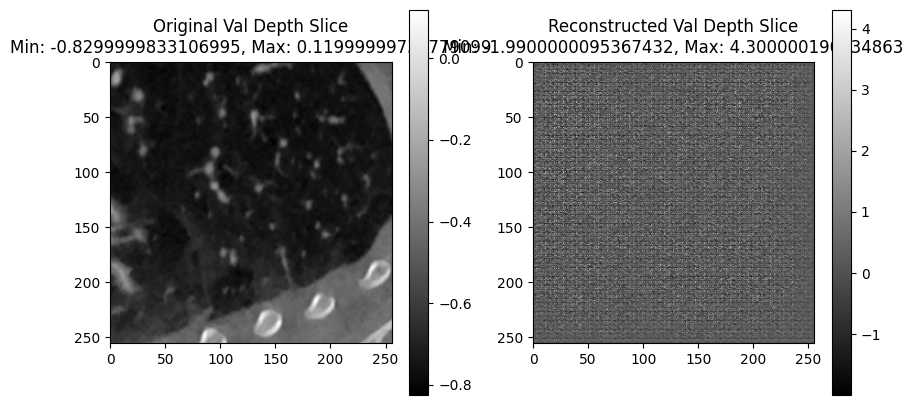

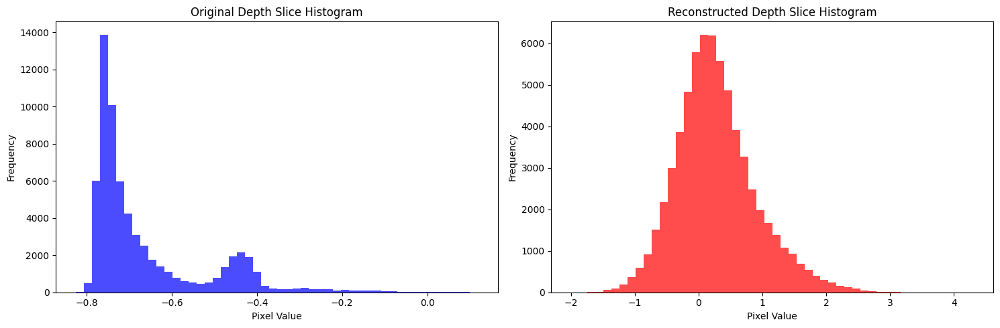

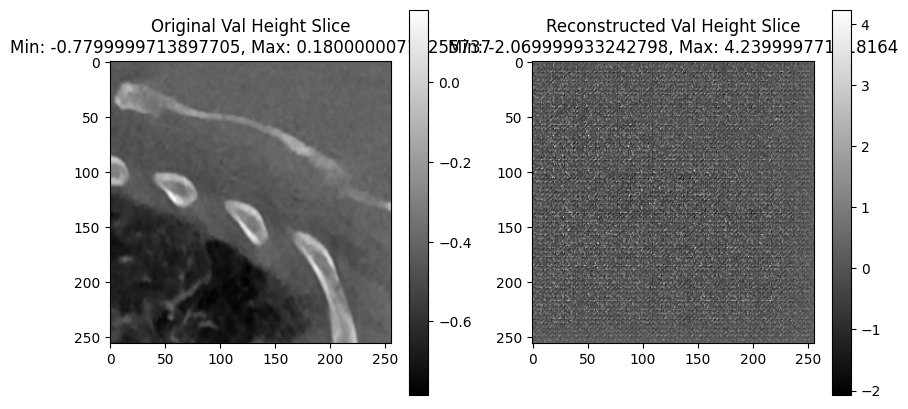

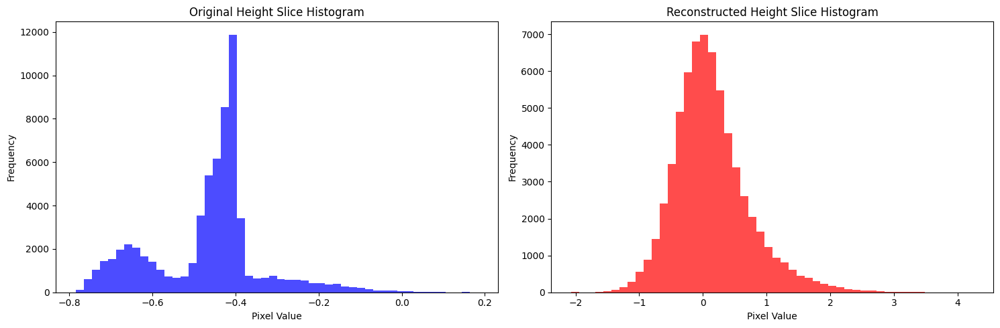

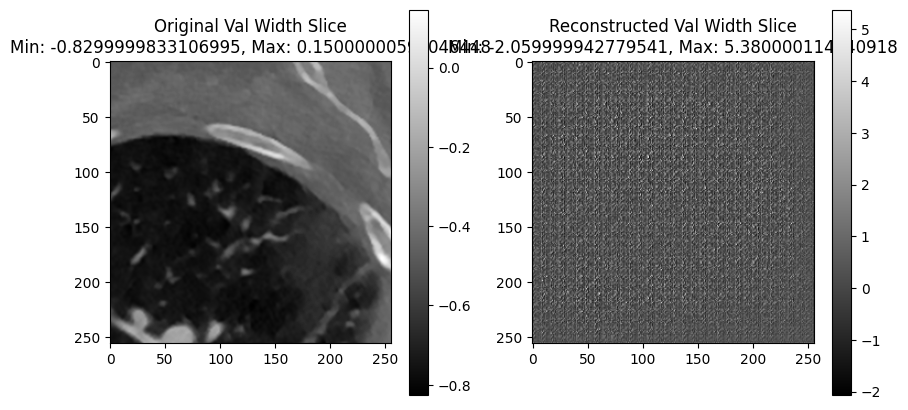

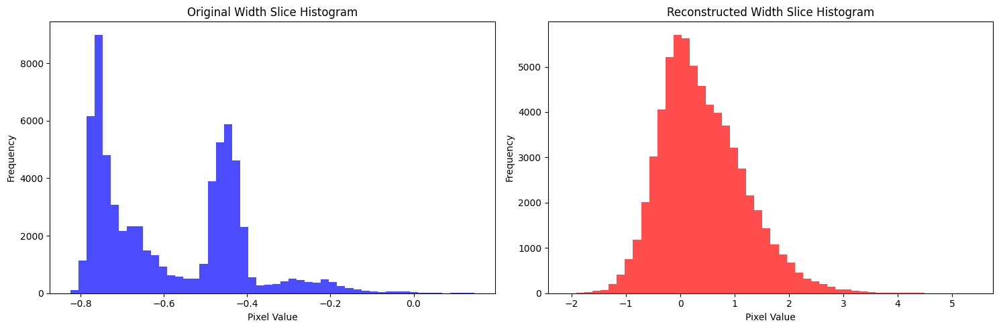

/old_Users/tgafrick/RA4/.venvE/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:441: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=63` in the `DataLoader` to improve performance.
/old_Users/tgafrick/RA4/.venvE/lib/python3.10/site-packages/pytorch_lightning/loops/fit_loop.py:298: The number of training batches (18) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Training: |          | 0/? [00:00<?, ?it/s]

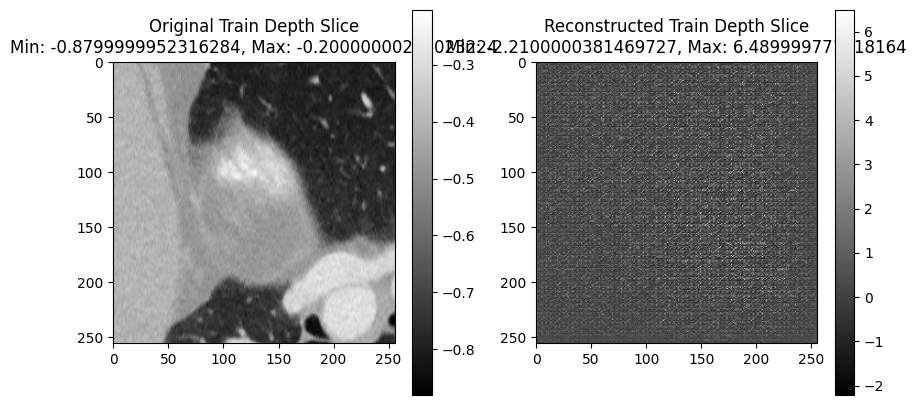

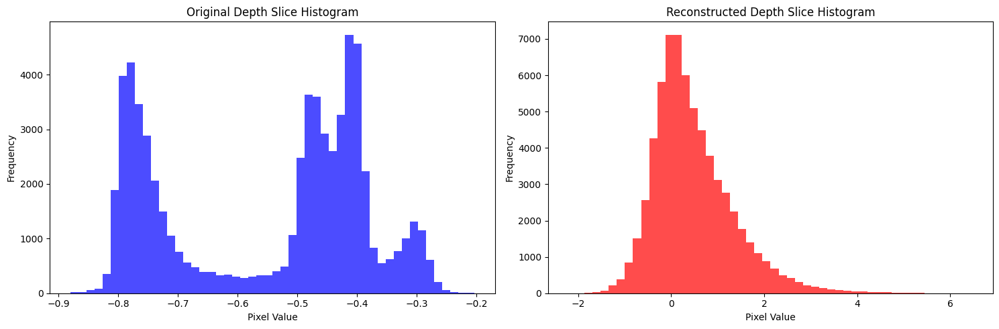

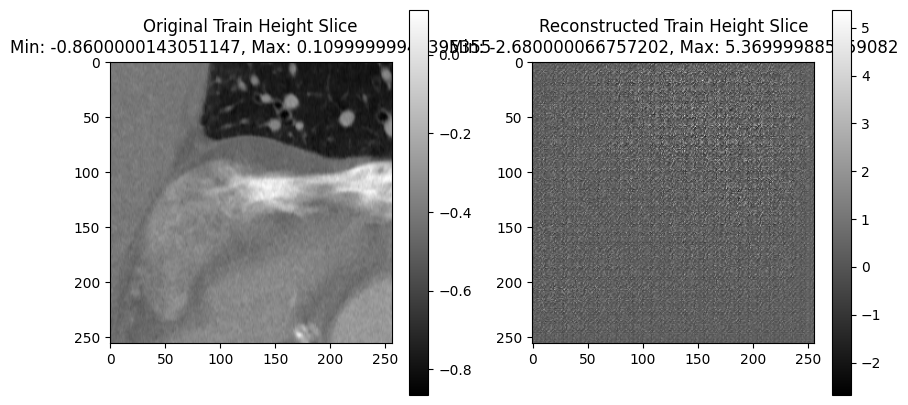

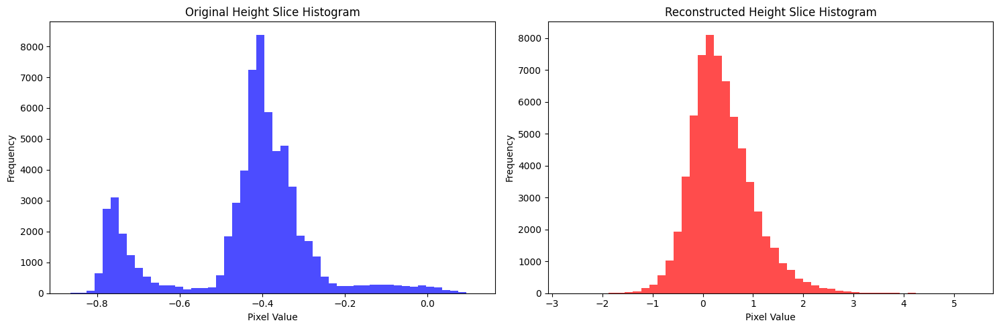

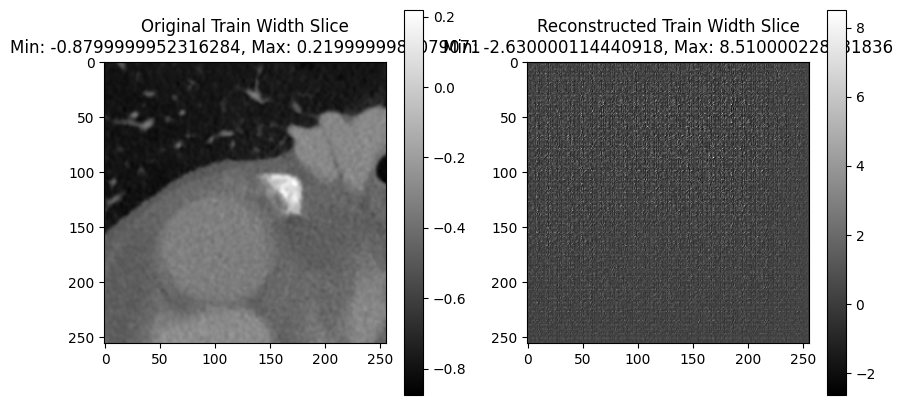

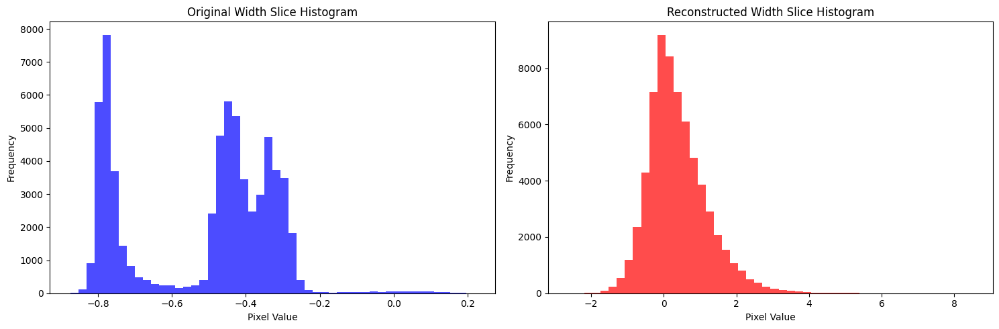

Validation: |          | 0/? [00:00<?, ?it/s]

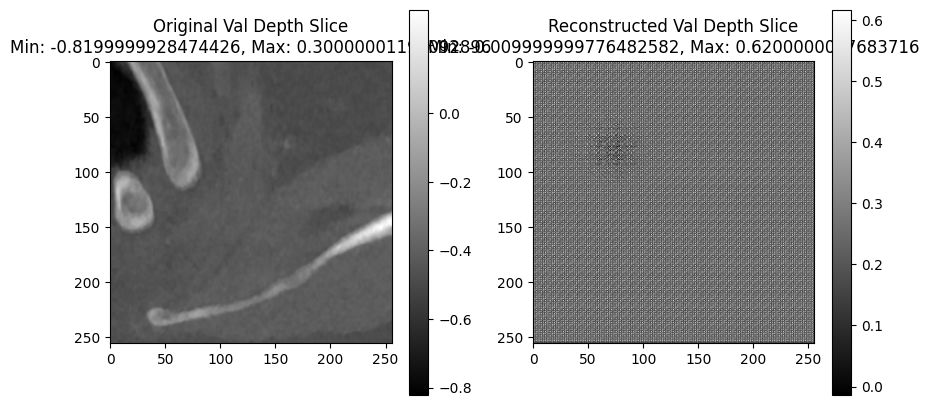

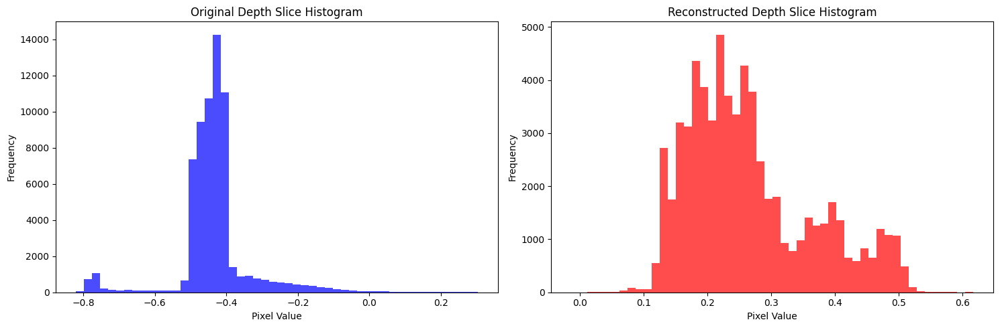

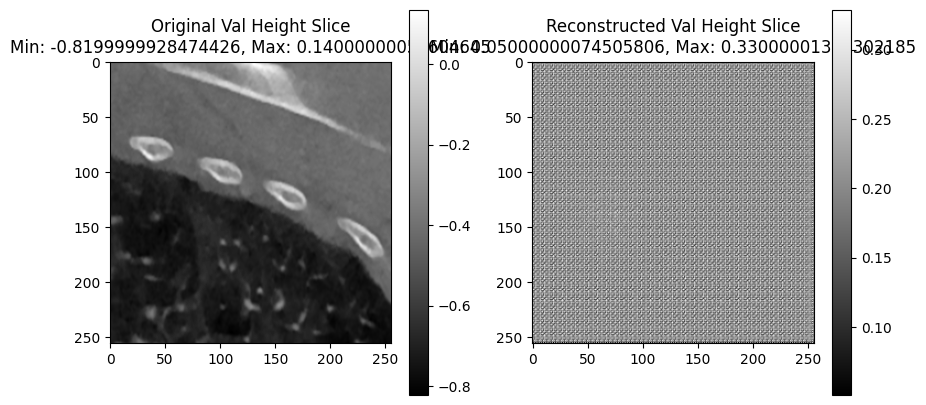

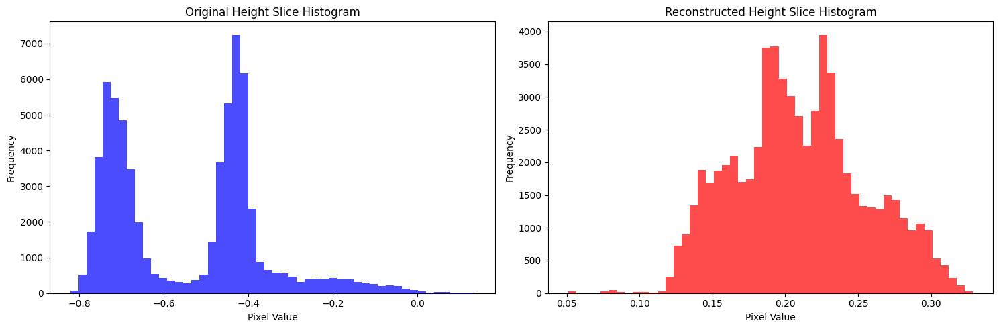

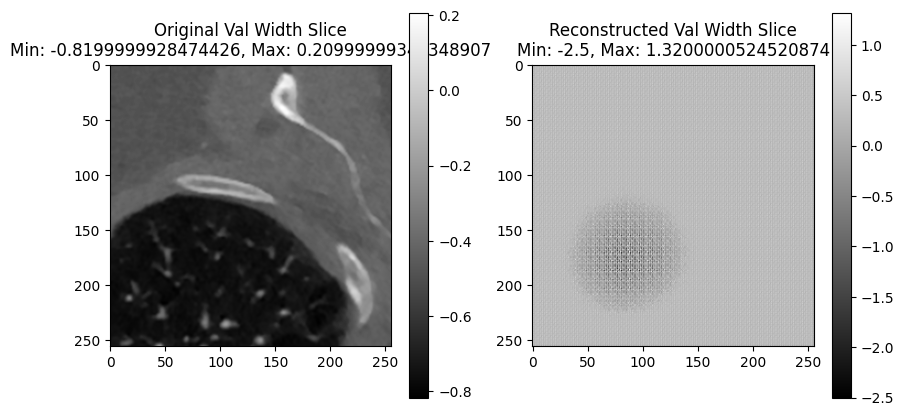

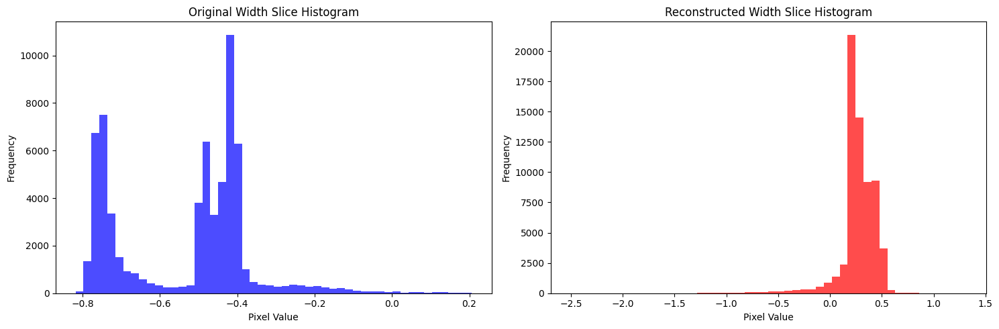

Time Spent 315.30
Epoch: 1


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 324.71
Epoch: 2


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 333.97
Epoch: 3


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 343.09
Epoch: 4


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 352.32
Epoch: 5


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 361.68
Epoch: 6


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 370.87
Epoch: 7


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 380.01
Epoch: 8


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 389.20
Epoch: 9


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 398.34
Epoch: 10


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 407.93
Epoch: 11


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 417.34
Epoch: 12


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 426.59
Epoch: 13


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 435.82
Epoch: 14


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 444.97
Epoch: 15


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 454.12
Epoch: 16


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 463.50
Epoch: 17


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 472.64
Epoch: 18


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 481.77
Epoch: 19


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 490.96
Epoch: 20


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 500.22
Epoch: 21


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 509.70
Epoch: 22


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 519.23
Epoch: 23


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 528.61
Epoch: 24


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 537.82
Epoch: 25


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 546.97
Epoch: 26


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 556.13
Epoch: 27


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 565.38
Epoch: 28


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 574.55
Epoch: 29


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 583.72
Epoch: 30


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 592.95
Epoch: 31


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 602.23
Epoch: 32


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 611.62
Epoch: 33


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 620.92
Epoch: 34


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 630.09
Epoch: 35


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 639.26
Epoch: 36


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 648.52
Epoch: 37


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 657.69
Epoch: 38


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 666.92
Epoch: 39


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 676.09
Epoch: 40


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 685.29
Epoch: 41


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 694.56
Epoch: 42


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 703.74
Epoch: 43


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 713.16
Epoch: 44


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 722.39
Epoch: 45


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 731.56
Epoch: 46


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 740.72
Epoch: 47


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 749.93
Epoch: 48


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 759.08
Epoch: 49


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 768.30
Epoch: 50


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 777.52
Epoch: 51


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 786.73
Epoch: 52


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 795.94
Epoch: 53


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 805.15
Epoch: 54


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 814.30
Epoch: 55


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 823.54
Epoch: 56


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 832.71
Epoch: 57


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 841.87
Epoch: 58


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 851.31
Epoch: 59


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 860.66
Epoch: 60


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 870.33
Epoch: 61


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 879.96
Epoch: 62


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 889.35
Epoch: 63


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 898.61
Epoch: 64


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 907.75
Epoch: 65


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 917.02
Epoch: 66


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 926.27
Epoch: 67


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 935.44
Epoch: 68


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 944.71
Epoch: 69


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 954.05
Epoch: 70


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 963.22
Epoch: 71


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 972.51
Epoch: 72


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 981.89
Epoch: 73


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 991.08
Epoch: 74


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1000.40
Epoch: 75


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1009.72
Epoch: 76


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1018.99
Epoch: 77


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1028.22
Epoch: 78


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1037.41
Epoch: 79


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1046.69
Epoch: 80


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1055.96
Epoch: 81


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1065.13
Epoch: 82


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1074.29
Epoch: 83


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1083.53
Epoch: 84


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1092.78
Epoch: 85


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1101.95
Epoch: 86


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1111.27
Epoch: 87


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1120.60
Epoch: 88


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1129.83
Epoch: 89


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1139.06
Epoch: 90


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1148.28
Epoch: 91


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1157.65
Epoch: 92


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1166.87
Epoch: 93


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1176.06
Epoch: 94


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1185.29
Epoch: 95


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1194.59
Epoch: 96


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1203.87
Epoch: 97


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1213.16
Epoch: 98


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1222.37
Epoch: 99


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1231.66
Epoch: 100


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1240.86
Epoch: 101


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1250.06
Epoch: 102


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1259.26
Epoch: 103


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1268.60
Epoch: 104


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1277.75
Epoch: 105


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1287.04
Epoch: 106


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1296.21
Epoch: 107


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1305.38
Epoch: 108


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1314.62
Epoch: 109


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1323.77
Epoch: 110


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1332.97
Epoch: 111


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1342.18
Epoch: 112


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1351.34
Epoch: 113


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1360.56
Epoch: 114


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1369.91
Epoch: 115


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1379.07
Epoch: 116


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1388.29
Epoch: 117


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1397.47
Epoch: 118


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1406.62
Epoch: 119


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1415.83
Epoch: 120


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1424.97
Epoch: 121


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1434.13
Epoch: 122


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1443.34
Epoch: 123


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1452.53
Epoch: 124


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1461.76
Epoch: 125


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1470.91
Epoch: 126


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1480.08
Epoch: 127


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1489.34
Epoch: 128


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1498.75
Epoch: 129


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1507.93
Epoch: 130


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1517.14
Epoch: 131


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1526.29
Epoch: 132


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1535.44
Epoch: 133


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1544.64
Epoch: 134


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1553.93
Epoch: 135


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1563.09
Epoch: 136


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1572.32
Epoch: 137


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1581.46
Epoch: 138


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1590.68
Epoch: 139


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1599.87
Epoch: 140


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1609.06
Epoch: 141


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1618.26
Epoch: 142


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1627.62
Epoch: 143


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1636.83
Epoch: 144


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1646.09
Epoch: 145


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1655.25
Epoch: 146


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1664.47
Epoch: 147


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1674.24
Epoch: 148


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1683.94
Epoch: 149


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1693.57
Epoch: 150


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1703.05
Epoch: 151


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1712.89
Epoch: 152


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1722.49
Epoch: 153


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1731.88
Epoch: 154


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1741.14
Epoch: 155


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1750.46
Epoch: 156


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1759.98
Epoch: 157


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1769.49
Epoch: 158


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1779.01
Epoch: 159


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1788.20
Epoch: 160


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1797.40
Epoch: 161


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1806.70
Epoch: 162


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1815.93
Epoch: 163


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1825.45
Epoch: 164


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1834.61
Epoch: 165


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1843.75
Epoch: 166


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1853.66
Epoch: 167


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1863.15
Epoch: 168


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1872.63
Epoch: 169


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1882.15
Epoch: 170


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1891.60
Epoch: 171


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1901.35
Epoch: 172


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1910.71
Epoch: 173


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1919.84
Epoch: 174


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1929.07
Epoch: 175


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1938.24
Epoch: 176


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1947.37
Epoch: 177


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1956.55
Epoch: 178


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1966.05
Epoch: 179


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1975.21
Epoch: 180


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1984.47
Epoch: 181


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1993.64
Epoch: 182


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2002.91
Epoch: 183


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2012.11
Epoch: 184


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2021.24
Epoch: 185


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2030.76
Epoch: 186


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2040.57
Epoch: 187


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2050.43
Epoch: 188


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2060.06
Epoch: 189


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2069.52
Epoch: 190


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2078.98
Epoch: 191


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2088.56
Epoch: 192


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2098.27
Epoch: 193


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2107.72
Epoch: 194


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2117.23
Epoch: 195


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2126.69
Epoch: 196


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2136.18
Epoch: 197


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2145.82
Epoch: 198


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2155.25
Epoch: 199


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2164.90
Epoch: 200


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2175.24
Epoch: 201


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2184.78
Epoch: 202


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2194.34
Epoch: 203


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2203.87
Epoch: 204


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2213.32
Epoch: 205


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2222.83
Epoch: 206


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2232.83
Epoch: 207


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2242.35
Epoch: 208


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2251.54
Epoch: 209


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2260.71
Epoch: 210


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2269.87
Epoch: 211


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2279.04
Epoch: 212


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2288.17
Epoch: 213


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2297.39
Epoch: 214


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2306.50
Epoch: 215


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2315.64
Epoch: 216


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2324.89
Epoch: 217


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2334.27
Epoch: 218


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2343.54
Epoch: 219


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2352.79
Epoch: 220


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2362.02
Epoch: 221


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2371.18
Epoch: 222


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2380.40
Epoch: 223


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2389.54
Epoch: 224


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2398.77
Epoch: 225


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2407.91
Epoch: 226


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2417.05
Epoch: 227


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2426.23
Epoch: 228


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2435.39
Epoch: 229


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2444.53
Epoch: 230


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2454.15
Epoch: 231


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2463.58
Epoch: 232


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2472.99
Epoch: 233


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2482.18
Epoch: 234


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2491.31
Epoch: 235


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2500.44
Epoch: 236


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2509.64
Epoch: 237


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2518.76
Epoch: 238


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2527.98
Epoch: 239


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2537.11
Epoch: 240


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2546.28
Epoch: 241


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2555.47
Epoch: 242


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2564.62
Epoch: 243


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2573.80
Epoch: 244


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2583.01
Epoch: 245


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2592.18
Epoch: 246


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2601.31
Epoch: 247


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2610.59
Epoch: 248


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2619.79
Epoch: 249


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2629.04
Epoch: 250


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2638.17
Epoch: 251


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2647.36
Epoch: 252


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2656.64
Epoch: 253


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2665.81
Epoch: 254


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2675.03
Epoch: 255


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2684.25
Epoch: 256


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2693.70
Epoch: 257


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2703.17
Epoch: 258


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2712.70
Epoch: 259


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2722.17
Epoch: 260


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2731.63
Epoch: 261


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2741.16
Epoch: 262


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2750.63
Epoch: 263


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2759.84
Epoch: 264


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2768.95
Epoch: 265


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2778.16
Epoch: 266


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2787.43
Epoch: 267


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2796.58
Epoch: 268


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2805.95
Epoch: 269


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2815.72
Epoch: 270


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2825.57
Epoch: 271


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2835.32
Epoch: 272


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2844.65
Epoch: 273


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2853.85
Epoch: 274


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2863.06
Epoch: 275


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2873.70
Epoch: 276


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2882.88
Epoch: 277


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2892.12
Epoch: 278


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2901.26
Epoch: 279


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2910.40
Epoch: 280


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2919.63
Epoch: 281


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2928.87
Epoch: 282


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2938.12
Epoch: 283


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2947.34
Epoch: 284


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2956.50
Epoch: 285


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2965.66
Epoch: 286


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2974.88
Epoch: 287


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2984.08
Epoch: 288


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2993.33
Epoch: 289


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3002.46
Epoch: 290


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3011.61
Epoch: 291


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3020.82
Epoch: 292


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3030.00
Epoch: 293


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3039.98
Epoch: 294


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3049.22
Epoch: 295


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3058.36
Epoch: 296


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3067.52
Epoch: 297


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3077.24
Epoch: 298


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3086.47
Epoch: 299


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3095.69
Epoch: 300


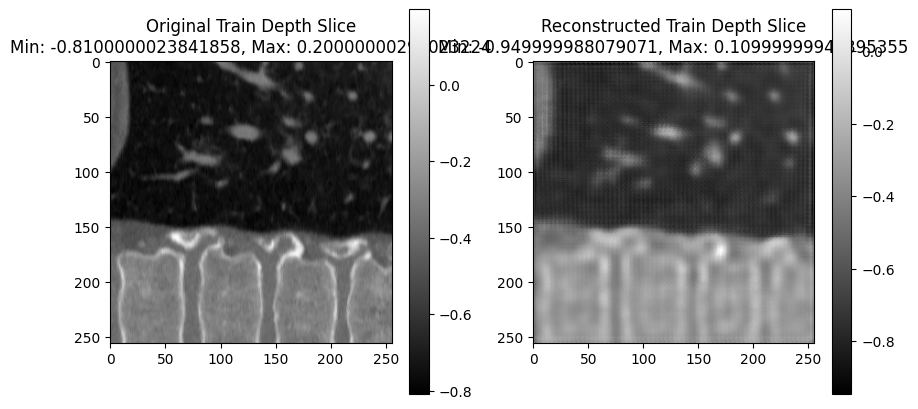

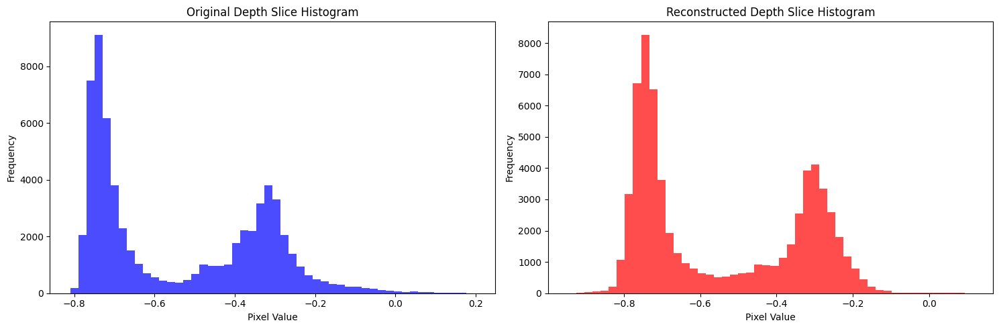

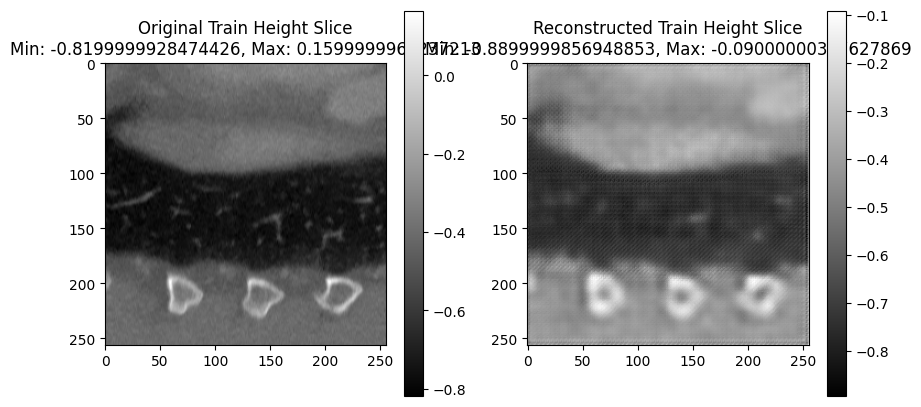

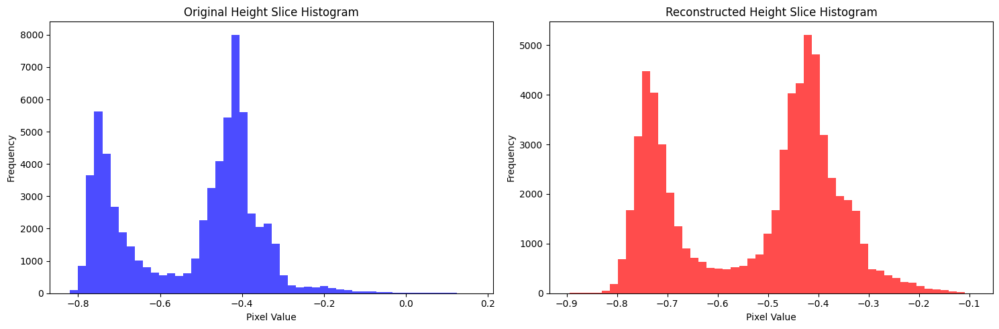

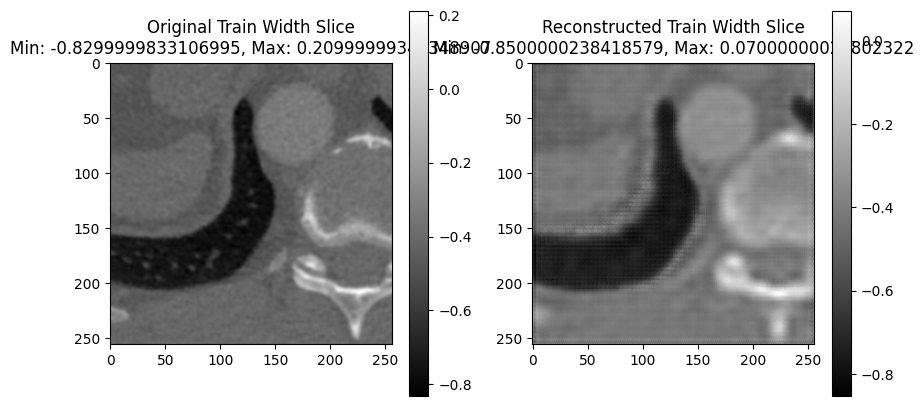

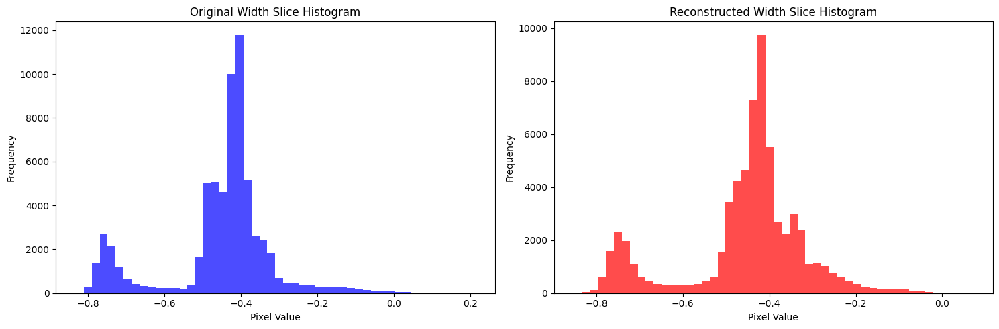

Validation: |          | 0/? [00:00<?, ?it/s]

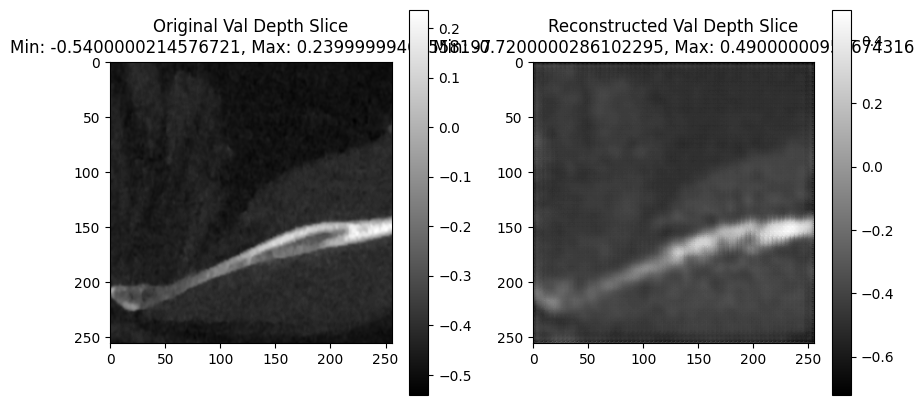

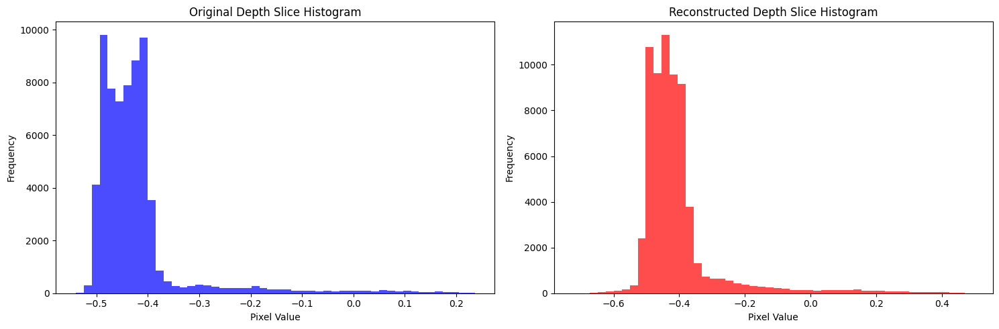

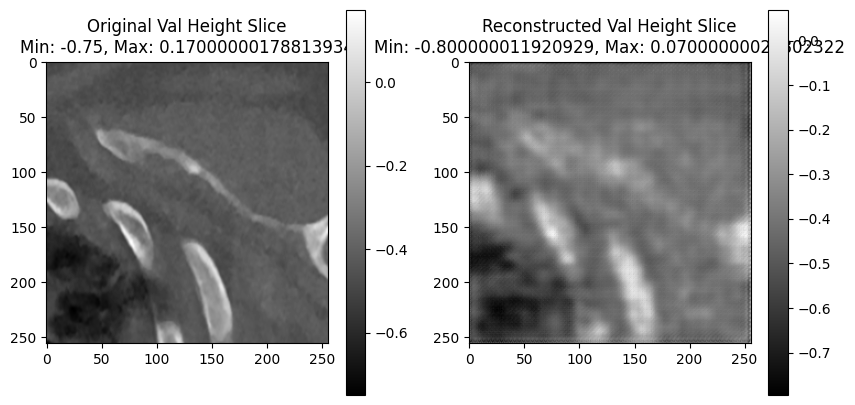

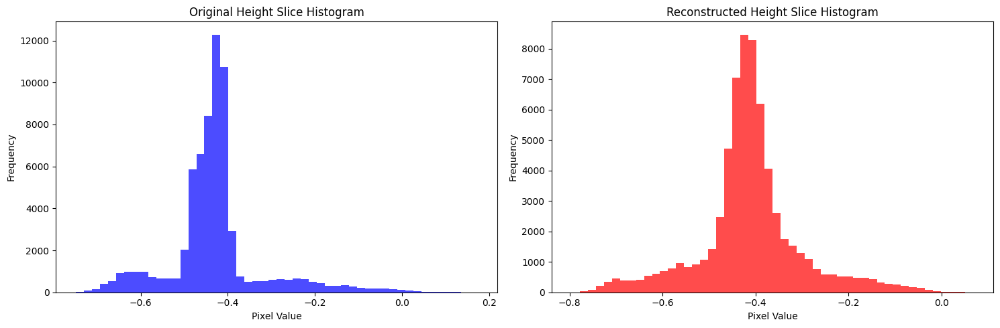

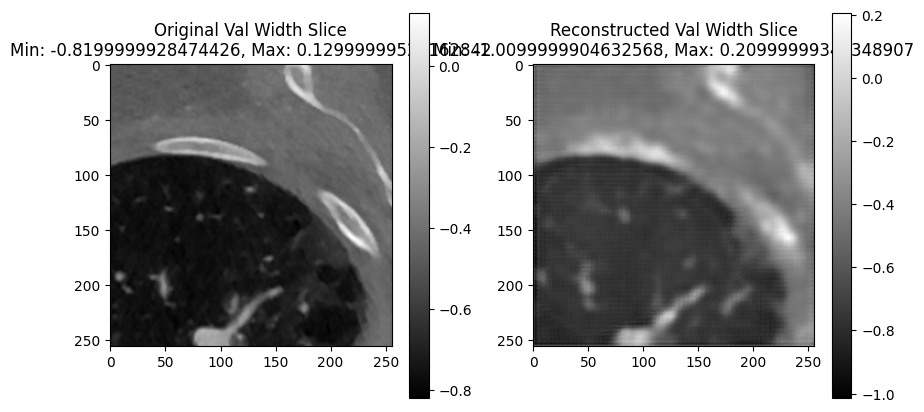

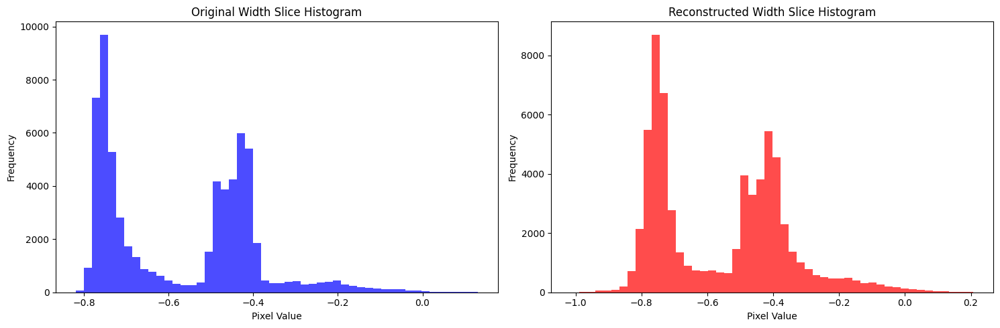

Time Spent 3112.14
Epoch: 301


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3121.33
Epoch: 302


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3130.54
Epoch: 303


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3139.71
Epoch: 304


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3148.90
Epoch: 305


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3158.15
Epoch: 306


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3167.31
Epoch: 307


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3176.50
Epoch: 308


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3185.98
Epoch: 309


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3195.74
Epoch: 310


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3205.21
Epoch: 311


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3214.99
Epoch: 312


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3224.45
Epoch: 313


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3233.99
Epoch: 314


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3243.58
Epoch: 315


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3253.04
Epoch: 316


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3262.56
Epoch: 317


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3272.05
Epoch: 318


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3281.51
Epoch: 319


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3291.09
Epoch: 320


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3300.57
Epoch: 321


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3310.26
Epoch: 322


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3319.79
Epoch: 323


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3329.03
Epoch: 324


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3338.25
Epoch: 325


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3347.39
Epoch: 326


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3356.59
Epoch: 327


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3365.80
Epoch: 328


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3374.93
Epoch: 329


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3384.09
Epoch: 330


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3393.27
Epoch: 331


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3402.41
Epoch: 332


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3411.56
Epoch: 333


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3420.96
Epoch: 334


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3430.44
Epoch: 335


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3439.64
Epoch: 336


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3448.88
Epoch: 337


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3458.04
Epoch: 338


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3467.34
Epoch: 339


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3476.48
Epoch: 340


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3485.66
Epoch: 341


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3494.87
Epoch: 342


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3504.01
Epoch: 343


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3513.14
Epoch: 344


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3522.32
Epoch: 345


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3531.44
Epoch: 346


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3540.61
Epoch: 347


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3549.84
Epoch: 348


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3559.00
Epoch: 349


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3568.21
Epoch: 350


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3577.36
Epoch: 351


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3586.52
Epoch: 352


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3596.09
Epoch: 353


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3605.23
Epoch: 354


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3614.35
Epoch: 355


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3623.58
Epoch: 356


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3632.73
Epoch: 357


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3641.97
Epoch: 358


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3651.16
Epoch: 359


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3660.34
Epoch: 360


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3669.61
Epoch: 361


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3678.87
Epoch: 362


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3687.98
Epoch: 363


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3697.15
Epoch: 364


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3706.30
Epoch: 365


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3715.41
Epoch: 366


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3724.66
Epoch: 367


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3733.77
Epoch: 368


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3743.21
Epoch: 369


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3752.72
Epoch: 370


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3762.18
Epoch: 371


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3771.50
Epoch: 372


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3780.88
Epoch: 373


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3790.57
Epoch: 374


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3800.11
Epoch: 375


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3809.60
Epoch: 376


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3819.07
Epoch: 377


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3828.60
Epoch: 378


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3838.06
Epoch: 379


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3847.23
Epoch: 380


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3856.45
Epoch: 381


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3865.66
Epoch: 382


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3874.92
Epoch: 383


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3884.14
Epoch: 384


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3893.30
Epoch: 385


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3902.50
Epoch: 386


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3911.77
Epoch: 387


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3920.94
Epoch: 388


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3930.17
Epoch: 389


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3939.40
Epoch: 390


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3948.56
Epoch: 391


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3957.76
Epoch: 392


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3966.92
Epoch: 393


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3976.07
Epoch: 394


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3985.27
Epoch: 395


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3994.44
Epoch: 396


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4003.62
Epoch: 397


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4014.03
Epoch: 398


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4023.19
Epoch: 399


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4032.46
Epoch: 400


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4042.70
Epoch: 401


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4051.86
Epoch: 402


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4061.07
Epoch: 403


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4070.22
Epoch: 404


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4079.37
Epoch: 405


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4088.58
Epoch: 406


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4097.78
Epoch: 407


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4106.97
Epoch: 408


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4116.17
Epoch: 409


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4125.33
Epoch: 410


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4134.50
Epoch: 411


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4143.72
Epoch: 412


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4152.90
Epoch: 413


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4162.11
Epoch: 414


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4171.30
Epoch: 415


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4180.57
Epoch: 416


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4189.74
Epoch: 417


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4198.89
Epoch: 418


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4208.01
Epoch: 419


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4217.20
Epoch: 420


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4226.35
Epoch: 421


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4235.48
Epoch: 422


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4244.67
Epoch: 423


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4253.80
Epoch: 424


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4263.03
Epoch: 425


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4272.15
Epoch: 426


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4281.30
Epoch: 427


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4290.53
Epoch: 428


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4299.72
Epoch: 429


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4308.94
Epoch: 430


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4318.11
Epoch: 431


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4327.23
Epoch: 432


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4336.34
Epoch: 433


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4345.51
Epoch: 434


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4354.65
Epoch: 435


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4363.80
Epoch: 436


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4373.03
Epoch: 437


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4382.17
Epoch: 438


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4391.37
Epoch: 439


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4400.55
Epoch: 440


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4409.82
Epoch: 441


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4419.06
Epoch: 442


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4428.23
Epoch: 443


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4437.38
Epoch: 444


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4446.59
Epoch: 445


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4455.78
Epoch: 446


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4464.92
Epoch: 447


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4474.14
Epoch: 448


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4483.31
Epoch: 449


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4492.60
Epoch: 450


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4501.77
Epoch: 451


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4510.93
Epoch: 452


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4520.69
Epoch: 453


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4529.88
Epoch: 454


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4539.04
Epoch: 455


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4548.28
Epoch: 456


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4557.81
Epoch: 457


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4566.98
Epoch: 458


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4576.19
Epoch: 459


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4585.36
Epoch: 460


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4594.57
Epoch: 461


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4603.87
Epoch: 462


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4613.31
Epoch: 463


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4622.84
Epoch: 464


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4632.34
Epoch: 465


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4641.80
Epoch: 466


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4651.32
Epoch: 467


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4660.78
Epoch: 468


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4670.11
Epoch: 469


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4679.33
Epoch: 470


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4688.48
Epoch: 471


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4697.65
Epoch: 472


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4707.07
Epoch: 473


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4716.54
Epoch: 474


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4726.01
Epoch: 475


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4735.19
Epoch: 476


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4744.36
Epoch: 477


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4753.58
Epoch: 478


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4762.76
Epoch: 479


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4771.95
Epoch: 480


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4781.17
Epoch: 481


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4790.49
Epoch: 482


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4799.97
Epoch: 483


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4809.52
Epoch: 484


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4818.78
Epoch: 485


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4827.99
Epoch: 486


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4837.21
Epoch: 487


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4846.44
Epoch: 488


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4855.79
Epoch: 489


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4864.95
Epoch: 490


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4874.11
Epoch: 491


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4883.46
Epoch: 492


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4892.69
Epoch: 493


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4901.87
Epoch: 494


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4911.09
Epoch: 495


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4920.26
Epoch: 496


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4929.44
Epoch: 497


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4938.65
Epoch: 498


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4947.91
Epoch: 499


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4957.13
Epoch: 500


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4966.35
Epoch: 501


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4975.83
Epoch: 502


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4985.41
Epoch: 503


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4994.90
Epoch: 504


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5004.36
Epoch: 505


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5013.80
Epoch: 506


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5022.95
Epoch: 507


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5032.09
Epoch: 508


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5041.31
Epoch: 509


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5050.53
Epoch: 510


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5059.68
Epoch: 511


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5069.09
Epoch: 512


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5078.26
Epoch: 513


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5087.60
Epoch: 514


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5097.07
Epoch: 515


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5106.24
Epoch: 516


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5115.45
Epoch: 517


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5124.60
Epoch: 518


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5133.80
Epoch: 519


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5143.12
Epoch: 520


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5152.76
Epoch: 521


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5162.48
Epoch: 522


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5172.00
Epoch: 523


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5181.46
Epoch: 524


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5191.01
Epoch: 525


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5200.47
Epoch: 526


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5209.97
Epoch: 527


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5219.48
Epoch: 528


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5228.68
Epoch: 529


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5237.82
Epoch: 530


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5247.13
Epoch: 531


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5256.27
Epoch: 532


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5265.41
Epoch: 533


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5274.77
Epoch: 534


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5284.05
Epoch: 535


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5293.19
Epoch: 536


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5302.40
Epoch: 537


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5311.56
Epoch: 538


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5321.19
Epoch: 539


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5330.64
Epoch: 540


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5340.10
Epoch: 541


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5349.36
Epoch: 542


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5358.58
Epoch: 543


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5367.73
Epoch: 544


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5377.04
Epoch: 545


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5386.29
Epoch: 546


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5395.57
Epoch: 547


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5405.12
Epoch: 548


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5414.57
Epoch: 549


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5424.09
Epoch: 550


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5433.61
Epoch: 551


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5443.07
Epoch: 552


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5452.64
Epoch: 553


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5462.09
Epoch: 554


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5471.46
Epoch: 555


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5481.04
Epoch: 556


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5490.40
Epoch: 557


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5499.55
Epoch: 558


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5508.88
Epoch: 559


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5518.04
Epoch: 560


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5527.18
Epoch: 561


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5536.39
Epoch: 562


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5545.56
Epoch: 563


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5554.77
Epoch: 564


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5563.91
Epoch: 565


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5573.07
Epoch: 566


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5582.28
Epoch: 567


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5591.43
Epoch: 568


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5600.57
Epoch: 569


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5609.81
Epoch: 570


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5618.95
Epoch: 571


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5628.10
Epoch: 572


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5637.30
Epoch: 573


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5646.54
Epoch: 574


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5655.80
Epoch: 575


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5664.95
Epoch: 576


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5674.09
Epoch: 577


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5683.30
Epoch: 578


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5692.44
Epoch: 579


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5701.65
Epoch: 580


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5710.89
Epoch: 581


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5720.07
Epoch: 582


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5729.27
Epoch: 583


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5738.52
Epoch: 584


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5747.85
Epoch: 585


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5757.47
Epoch: 586


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5767.12
Epoch: 587


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5776.39
Epoch: 588


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5786.05
Epoch: 589


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5795.96
Epoch: 590


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5805.35
Epoch: 591


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5814.60
Epoch: 592


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5823.75
Epoch: 593


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5833.30
Epoch: 594


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5842.81
Epoch: 595


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5851.96
Epoch: 596


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5861.46
Epoch: 597


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5871.05
Epoch: 598


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5880.23
Epoch: 599


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5889.55
Epoch: 600


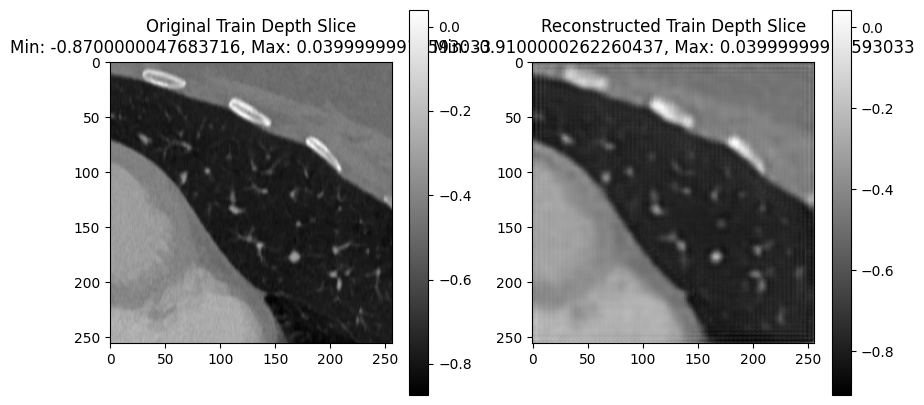

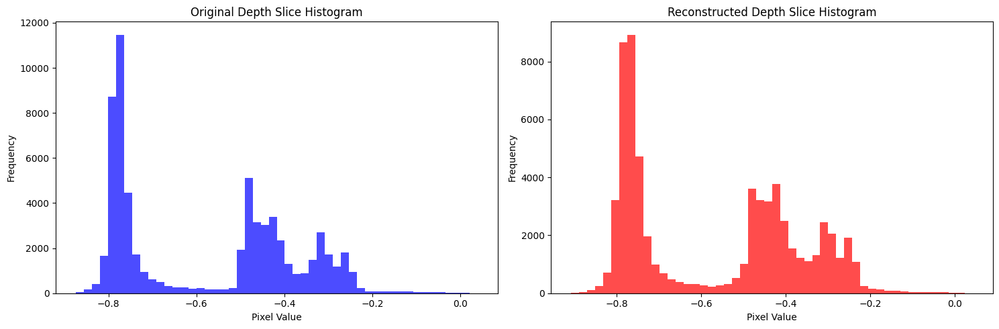

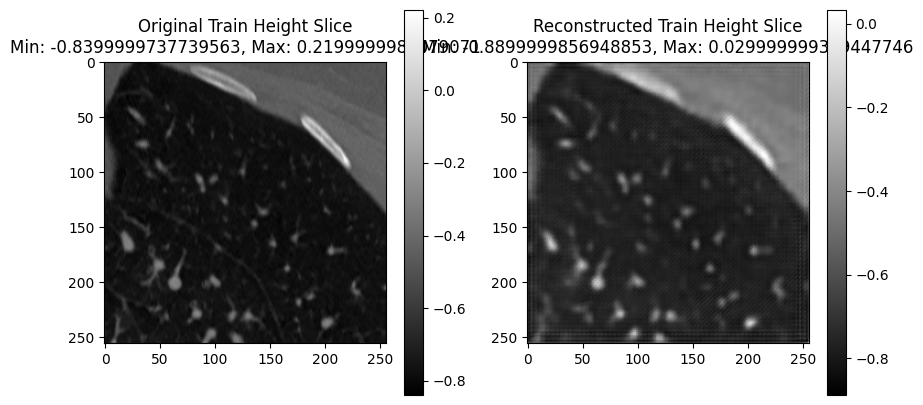

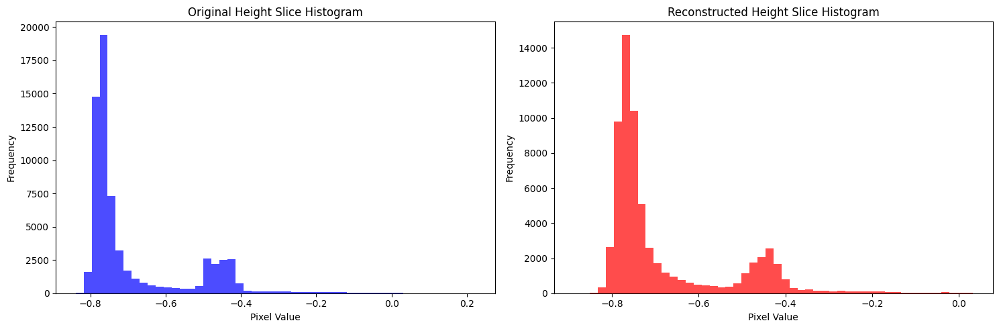

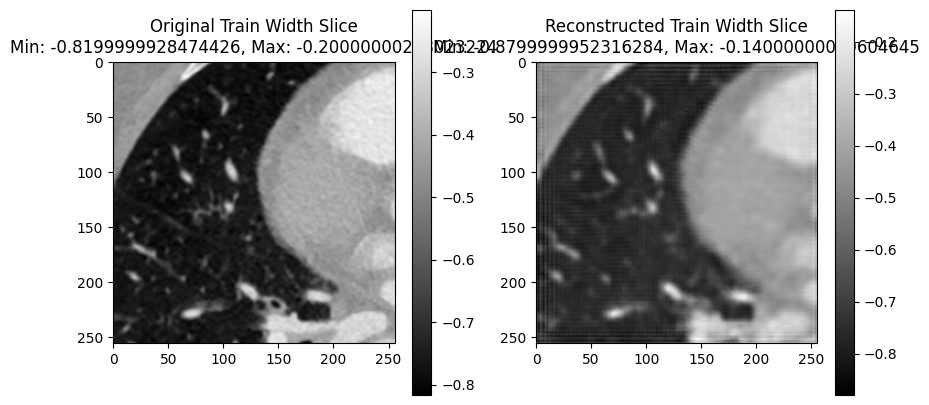

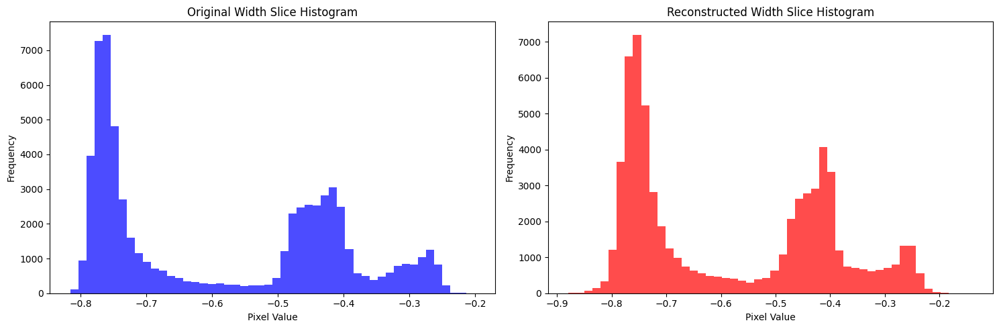

Validation: |          | 0/? [00:00<?, ?it/s]

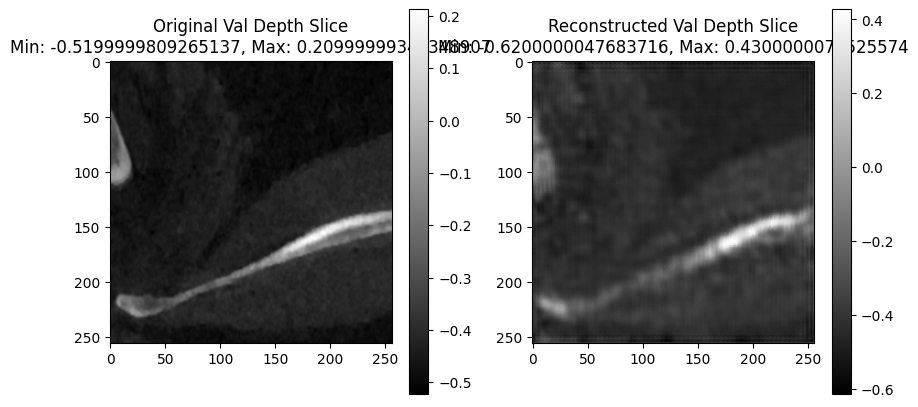

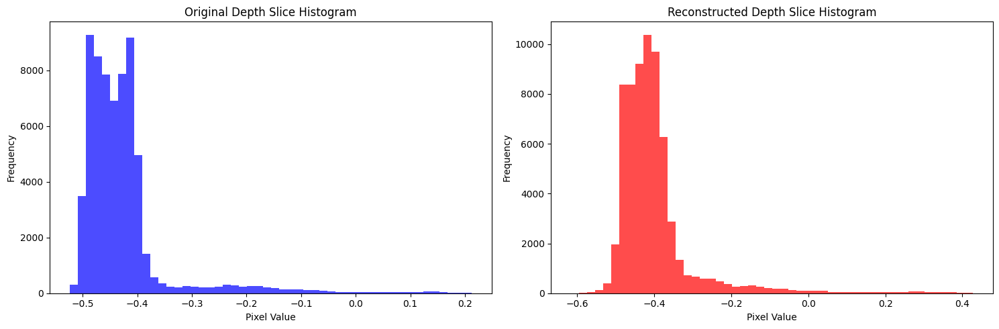

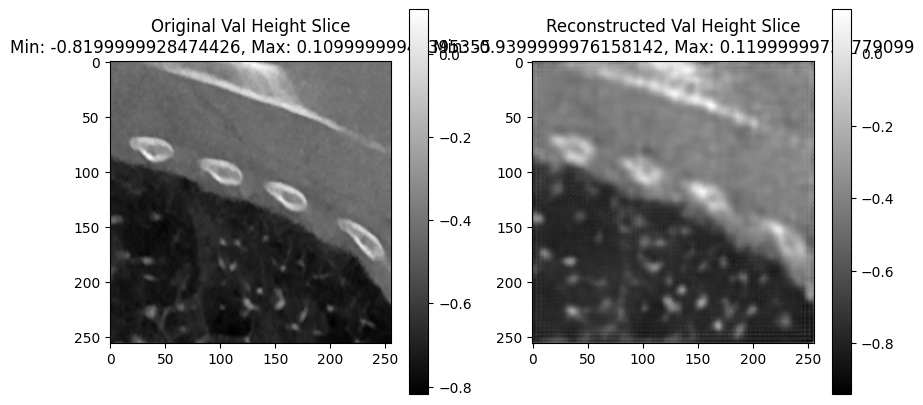

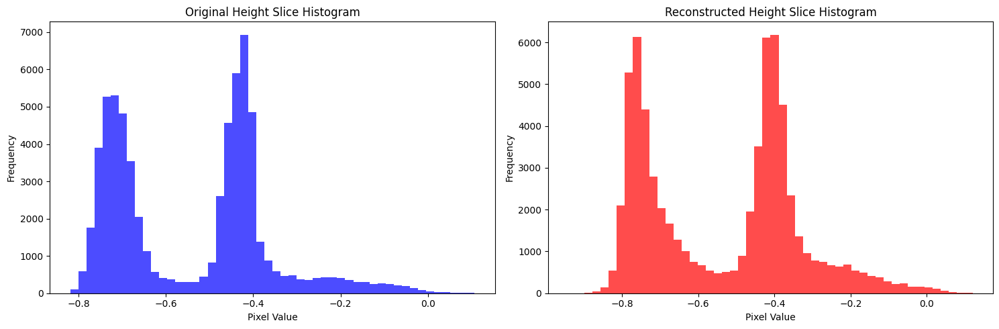

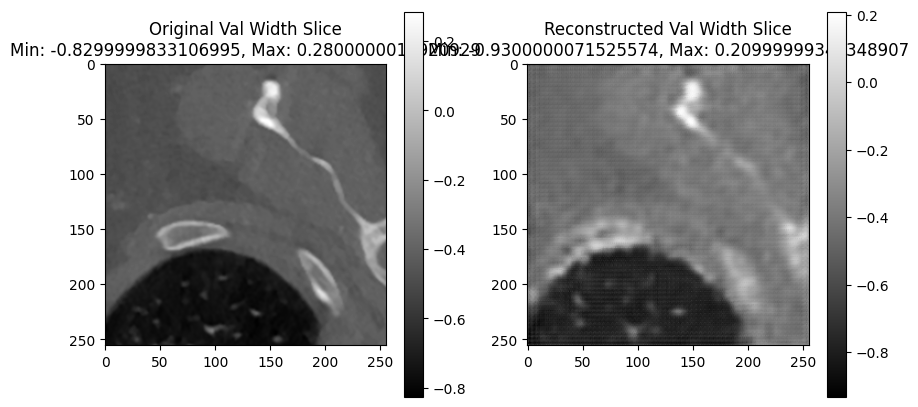

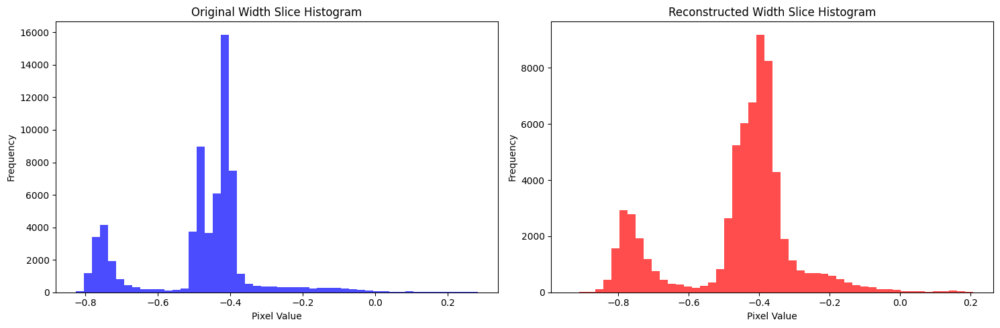

Time Spent 5906.32
Epoch: 601


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5915.45
Epoch: 602


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5924.67
Epoch: 603


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5934.04
Epoch: 604


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5943.51
Epoch: 605


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5953.10
Epoch: 606


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5962.58
Epoch: 607


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5972.07
Epoch: 608


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5981.41
Epoch: 609


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5990.55
Epoch: 610


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5999.67
Epoch: 611


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6008.87
Epoch: 612


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6018.01
Epoch: 613


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6027.20
Epoch: 614


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6036.34
Epoch: 615


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6045.51
Epoch: 616


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6054.69
Epoch: 617


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6063.96
Epoch: 618


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6073.11
Epoch: 619


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6082.42
Epoch: 620


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6091.55
Epoch: 621


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6100.67
Epoch: 622


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6109.98
Epoch: 623


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6119.45
Epoch: 624


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6128.77
Epoch: 625


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6138.00
Epoch: 626


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6147.16
Epoch: 627


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6156.40
Epoch: 628


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6165.56
Epoch: 629


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6174.71
Epoch: 630


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6183.91
Epoch: 631


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6193.08
Epoch: 632


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6202.33
Epoch: 633


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6211.53
Epoch: 634


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6220.69
Epoch: 635


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6229.89
Epoch: 636


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6239.21
Epoch: 637


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6248.36
Epoch: 638


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6257.56
Epoch: 639


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6266.72
Epoch: 640


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6275.89
Epoch: 641


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6285.15
Epoch: 642


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6294.30
Epoch: 643


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6303.43
Epoch: 644


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6312.69
Epoch: 645


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6321.90
Epoch: 646


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6331.04
Epoch: 647


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6340.30
Epoch: 648


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6349.51
Epoch: 649


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6359.01
Epoch: 650


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6368.48
Epoch: 651


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6377.70
Epoch: 652


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6386.93
Epoch: 653


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6396.12
Epoch: 654


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6405.41
Epoch: 655


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6415.06
Epoch: 656


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6424.40
Epoch: 657


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6433.83
Epoch: 658


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6443.29
Epoch: 659


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6453.00
Epoch: 660


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6462.56
Epoch: 661


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6472.14
Epoch: 662


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6481.36
Epoch: 663


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6491.04
Epoch: 664


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6500.27
Epoch: 665


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6509.50
Epoch: 666


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6518.72
Epoch: 667


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6527.99
Epoch: 668


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6537.13
Epoch: 669


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6546.49
Epoch: 670


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6555.91
Epoch: 671


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6565.35
Epoch: 672


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6574.88
Epoch: 673


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6584.19
Epoch: 674


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6593.41
Epoch: 675


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6602.75
Epoch: 676


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6612.07
Epoch: 677


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6621.36
Epoch: 678


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6630.78
Epoch: 679


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6639.99
Epoch: 680


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6649.21
Epoch: 681


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6658.43
Epoch: 682


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6667.57
Epoch: 683


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6676.79
Epoch: 684


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6685.94
Epoch: 685


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6695.07
Epoch: 686


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6704.25
Epoch: 687


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6713.39
Epoch: 688


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6723.26
Epoch: 689


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6732.38
Epoch: 690


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6741.51
Epoch: 691


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6750.70
Epoch: 692


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6759.83
Epoch: 693


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6768.97
Epoch: 694


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6778.47
Epoch: 695


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6787.99
Epoch: 696


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6797.46
Epoch: 697


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6806.96
Epoch: 698


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6816.42
Epoch: 699


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6826.12
Epoch: 700


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6835.58
Epoch: 701


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6845.06
Epoch: 702


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6854.59
Epoch: 703


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6864.07
Epoch: 704


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6873.53
Epoch: 705


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6883.20
Epoch: 706


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6892.62
Epoch: 707


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6902.09
Epoch: 708


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6911.61
Epoch: 709


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6921.03
Epoch: 710


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6930.50
Epoch: 711


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6940.02
Epoch: 712


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6949.35
Epoch: 713


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6958.54
Epoch: 714


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6967.69
Epoch: 715


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6976.87
Epoch: 716


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6986.09
Epoch: 717


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6995.27
Epoch: 718


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7004.46
Epoch: 719


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7013.66
Epoch: 720


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7022.80
Epoch: 721


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7031.97
Epoch: 722


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7041.15
Epoch: 723


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7050.36
Epoch: 724


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7059.58
Epoch: 725


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7068.71
Epoch: 726


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7077.85
Epoch: 727


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7087.03
Epoch: 728


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7096.17
Epoch: 729


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7105.31
Epoch: 730


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7114.56
Epoch: 731


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7123.69
Epoch: 732


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7132.82
Epoch: 733


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7142.03
Epoch: 734


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7151.17
Epoch: 735


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7160.32
Epoch: 736


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7169.55
Epoch: 737


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7178.67
Epoch: 738


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7187.87
Epoch: 739


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7196.99
Epoch: 740


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7206.11
Epoch: 741


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7215.28
Epoch: 742


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7224.42
Epoch: 743


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7233.54
Epoch: 744


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7242.72
Epoch: 745


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7251.88
Epoch: 746


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7261.00
Epoch: 747


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7270.18
Epoch: 748


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7279.31
Epoch: 749


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7288.51
Epoch: 750


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7297.63
Epoch: 751


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7306.80
Epoch: 752


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7315.98
Epoch: 753


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7325.10
Epoch: 754


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7334.23
Epoch: 755


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7343.40
Epoch: 756


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7352.52
Epoch: 757


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7361.66
Epoch: 758


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7370.84
Epoch: 759


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7379.99
Epoch: 760


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7389.11
Epoch: 761


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7398.28
Epoch: 762


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7407.40
Epoch: 763


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7416.61
Epoch: 764


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7426.09
Epoch: 765


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7435.67
Epoch: 766


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7444.91
Epoch: 767


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7454.06
Epoch: 768


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7463.25
Epoch: 769


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7472.53
Epoch: 770


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7481.69
Epoch: 771


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7490.87
Epoch: 772


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7500.22
Epoch: 773


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7509.69
Epoch: 774


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7519.21
Epoch: 775


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7528.45
Epoch: 776


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7537.71
Epoch: 777


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7547.09
Epoch: 778


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7556.23
Epoch: 779


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7565.41
Epoch: 780


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7574.61
Epoch: 781


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7583.75
Epoch: 782


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7592.88
Epoch: 783


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7602.07
Epoch: 784


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7611.40
Epoch: 785


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7622.29
Epoch: 786


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7631.82
Epoch: 787


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7641.28
Epoch: 788


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7650.85
Epoch: 789


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7660.02
Epoch: 790


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7669.28
Epoch: 791


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7678.74
Epoch: 792


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7687.86
Epoch: 793


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7696.98
Epoch: 794


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7706.16
Epoch: 795


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7715.27
Epoch: 796


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7724.38
Epoch: 797


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7733.55
Epoch: 798


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7742.67
Epoch: 799


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7751.85
Epoch: 800


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7762.28
Epoch: 801


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7771.39
Epoch: 802


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7780.57
Epoch: 803


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7789.69
Epoch: 804


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7798.82
Epoch: 805


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7808.02
Epoch: 806


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7817.16
Epoch: 807


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7826.29
Epoch: 808


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7835.50
Epoch: 809


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7845.01
Epoch: 810


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7854.46
Epoch: 811


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7863.97
Epoch: 812


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7873.44
Epoch: 813


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7882.73
Epoch: 814


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7891.96
Epoch: 815


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7901.09
Epoch: 816


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7910.39
Epoch: 817


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7919.88
Epoch: 818


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7929.37
Epoch: 819


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7938.89
Epoch: 820


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7948.08
Epoch: 821


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7957.22
Epoch: 822


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7966.42
Epoch: 823


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7975.62
Epoch: 824


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7984.83
Epoch: 825


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7994.03
Epoch: 826


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8003.29
Epoch: 827


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8012.50
Epoch: 828


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8021.67
Epoch: 829


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8030.88
Epoch: 830


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8040.10
Epoch: 831


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8049.32
Epoch: 832


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8058.55
Epoch: 833


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8067.80
Epoch: 834


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8077.09
Epoch: 835


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8086.24
Epoch: 836


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8095.61
Epoch: 837


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8104.76
Epoch: 838


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8114.05
Epoch: 839


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8123.24
Epoch: 840


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8132.41
Epoch: 841


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8141.63
Epoch: 842


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8150.81
Epoch: 843


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8160.20
Epoch: 844


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8169.77
Epoch: 845


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8180.27
Epoch: 846


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8189.64
Epoch: 847


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8198.89
Epoch: 848


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8208.16
Epoch: 849


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8217.54
Epoch: 850


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8226.85
Epoch: 851


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8236.35
Epoch: 852


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8245.73
Epoch: 853


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8255.08
Epoch: 854


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8264.28
Epoch: 855


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8273.80
Epoch: 856


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8283.27
Epoch: 857


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8292.75
Epoch: 858


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8302.43
Epoch: 859


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8311.88
Epoch: 860


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8321.64
Epoch: 861


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8331.18
Epoch: 862


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8340.67
Epoch: 863


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8350.22
Epoch: 864


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8359.74
Epoch: 865


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8369.19
Epoch: 866


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8378.71
Epoch: 867


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8388.24
Epoch: 868


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8397.80
Epoch: 869


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8407.37
Epoch: 870


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8416.84
Epoch: 871


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8426.36
Epoch: 872


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8436.00
Epoch: 873


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8445.47
Epoch: 874


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8454.95
Epoch: 875


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8464.41
Epoch: 876


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8473.90
Epoch: 877


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8483.45
Epoch: 878


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8493.02
Epoch: 879


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8502.47
Epoch: 880


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8512.00
Epoch: 881


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8521.48
Epoch: 882


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8530.95
Epoch: 883


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8540.34
Epoch: 884


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8549.52
Epoch: 885


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8558.72
Epoch: 886


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8567.94
Epoch: 887


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8577.08
Epoch: 888


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8586.28
Epoch: 889


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8595.43
Epoch: 890


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8604.62
Epoch: 891


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8613.81
Epoch: 892


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8622.96
Epoch: 893


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8632.08
Epoch: 894


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8641.27
Epoch: 895


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8650.39
Epoch: 896


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8659.52
Epoch: 897


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8668.73
Epoch: 898


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8677.85
Epoch: 899


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8687.05
Epoch: 900


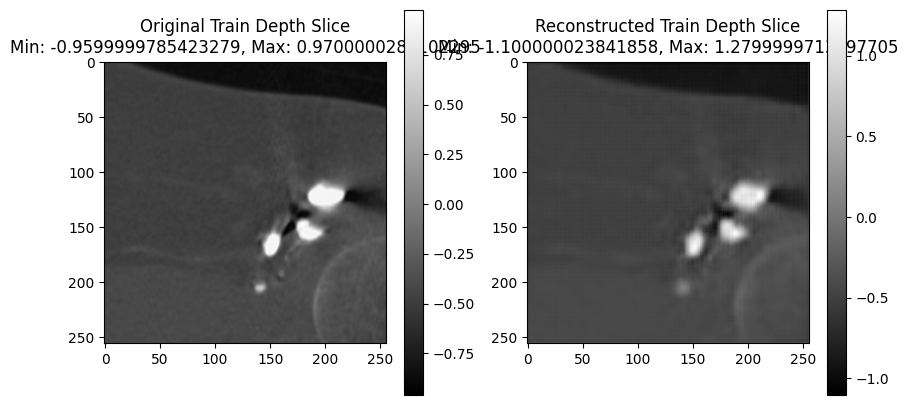

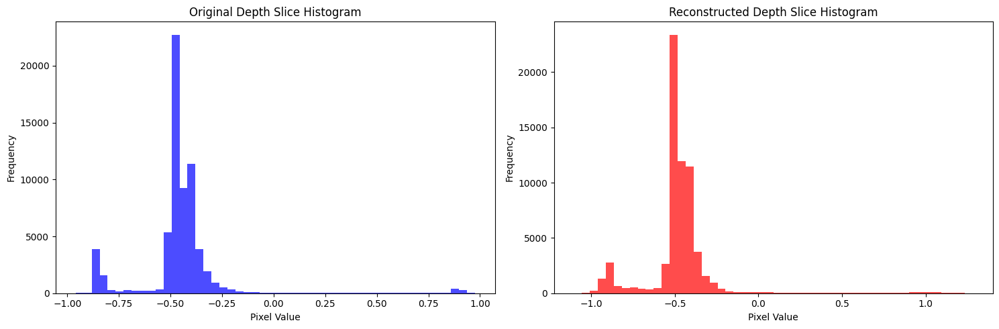

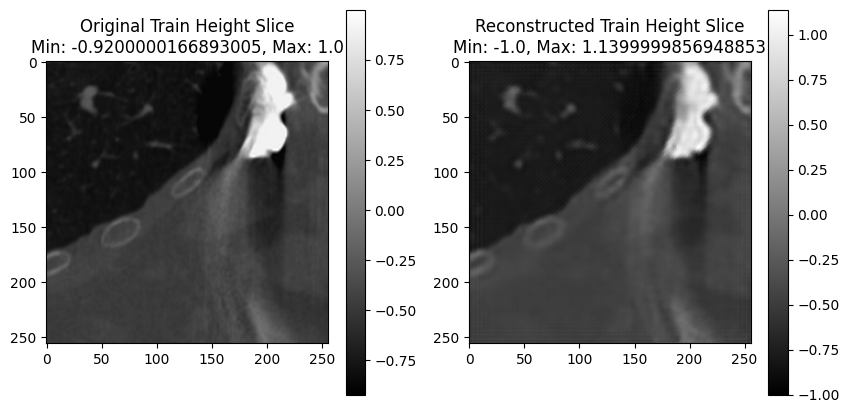

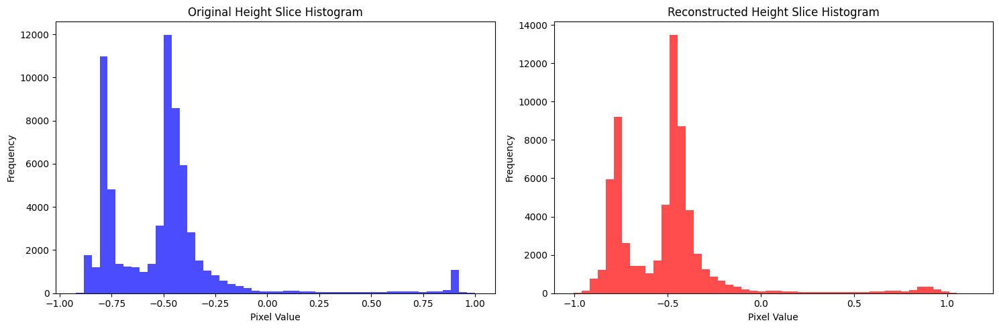

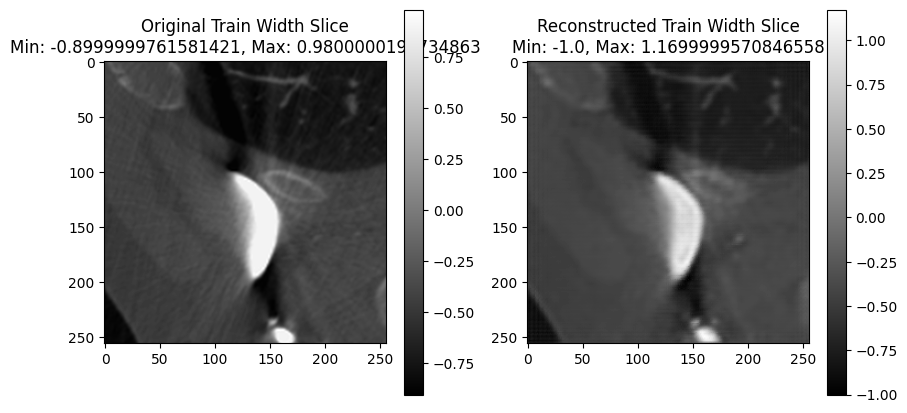

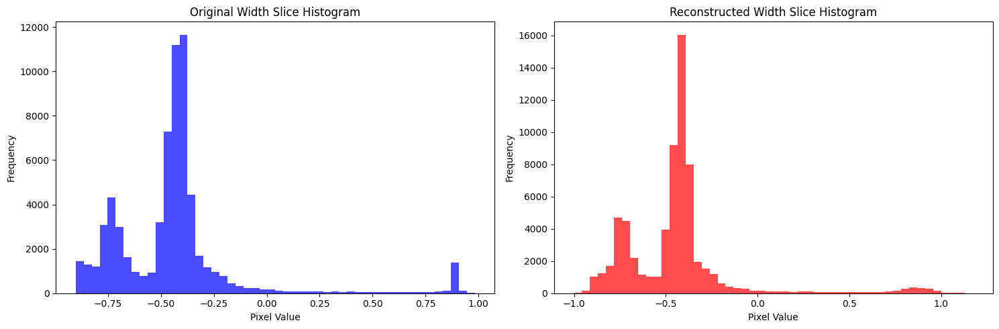

Validation: |          | 0/? [00:00<?, ?it/s]

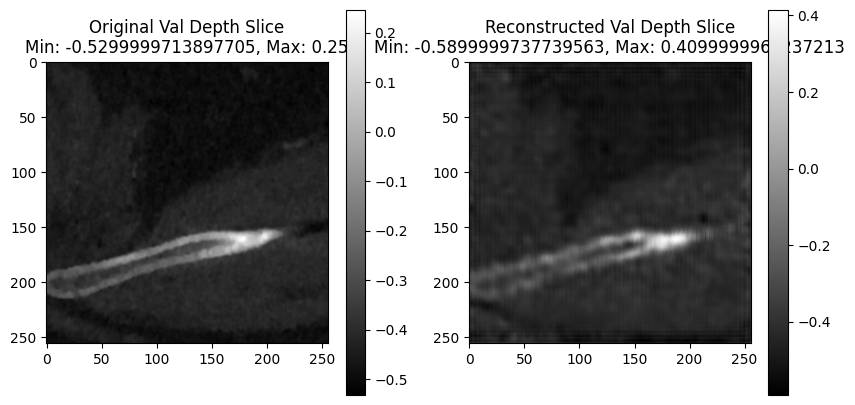

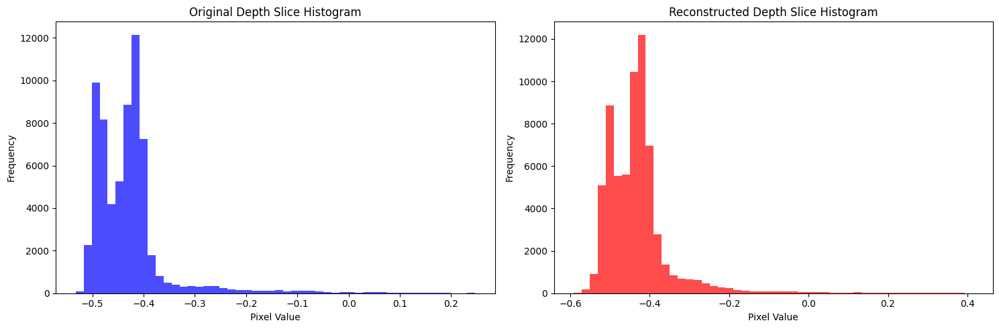

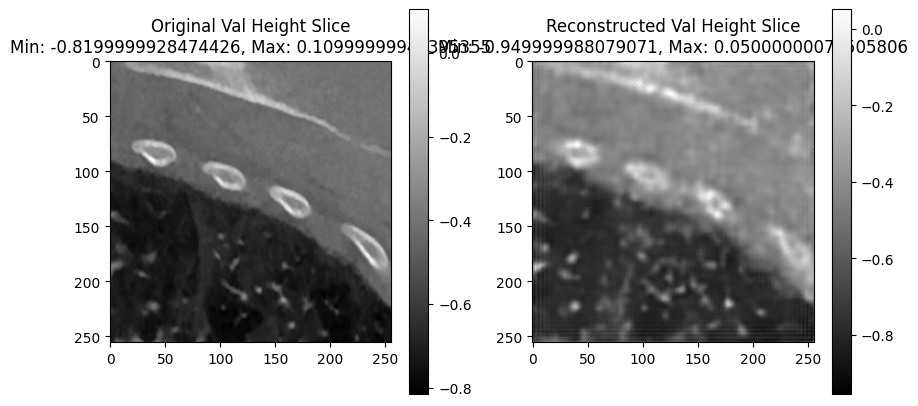

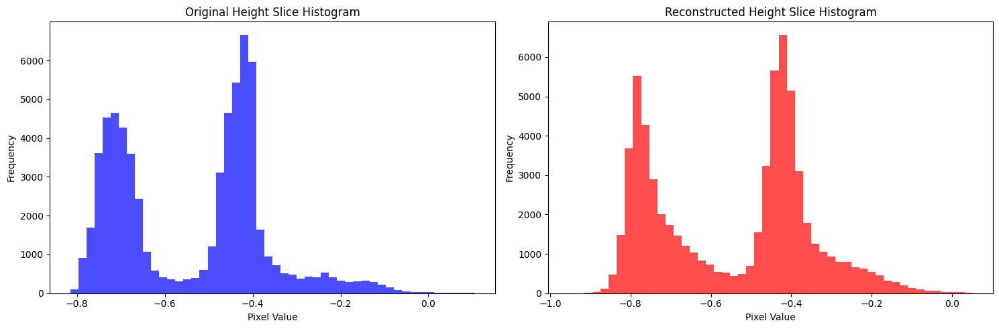

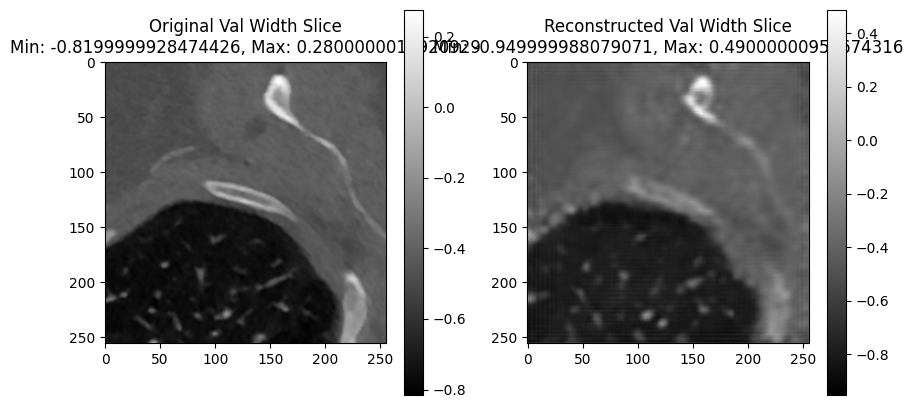

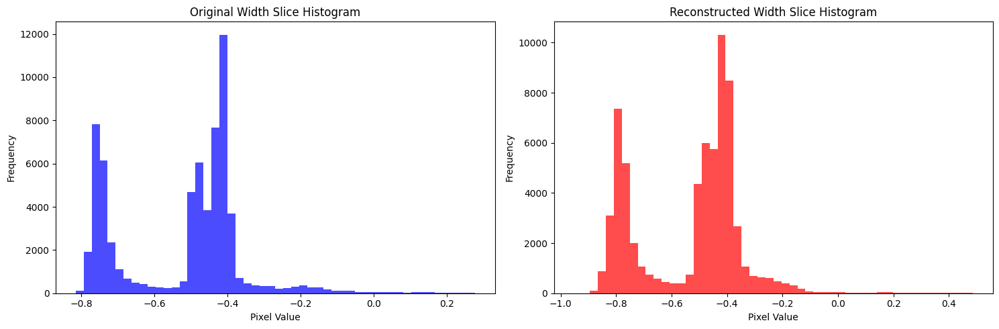

Time Spent 8702.98
Epoch: 901


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8712.10
Epoch: 902


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8721.30
Epoch: 903


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8730.45
Epoch: 904


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8739.64
Epoch: 905


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8748.90
Epoch: 906


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8758.13
Epoch: 907


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8767.28
Epoch: 908


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8776.49
Epoch: 909


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8785.64
Epoch: 910


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8794.83
Epoch: 911


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8804.05
Epoch: 912


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8813.21
Epoch: 913


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8822.41
Epoch: 914


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8831.58
Epoch: 915


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8840.73
Epoch: 916


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8849.93
Epoch: 917


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8859.12
Epoch: 918


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8868.25
Epoch: 919


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8877.43
Epoch: 920


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8886.56
Epoch: 921


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8895.70
Epoch: 922


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8904.92
Epoch: 923


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8914.04
Epoch: 924


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8923.23
Epoch: 925


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8932.36
Epoch: 926


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8941.48
Epoch: 927


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8950.68
Epoch: 928


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8959.82
Epoch: 929


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8968.95
Epoch: 930


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8978.13
Epoch: 931


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8987.32
Epoch: 932


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8996.85
Epoch: 933


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9006.39
Epoch: 934


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9015.86
Epoch: 935


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9025.03
Epoch: 936


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9034.24
Epoch: 937


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9043.41
Epoch: 938


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9052.61
Epoch: 939


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9064.36
Epoch: 940


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9073.50
Epoch: 941


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9082.70
Epoch: 942


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9091.83
Epoch: 943


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9101.01
Epoch: 944


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9110.23
Epoch: 945


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9119.40
Epoch: 946


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9128.58
Epoch: 947


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9137.81
Epoch: 948


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9146.97
Epoch: 949


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9156.17
Epoch: 950


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9165.36
Epoch: 951


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9174.89
Epoch: 952


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9184.41
Epoch: 953


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9193.87
Epoch: 954


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9203.05
Epoch: 955


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9212.24
Epoch: 956


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9221.41
Epoch: 957


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9230.57
Epoch: 958


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9240.07
Epoch: 959


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9249.29
Epoch: 960


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9258.43
Epoch: 961


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9267.91
Epoch: 962


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9277.58
Epoch: 963


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9287.11
Epoch: 964


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9296.24
Epoch: 965


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9308.71
Epoch: 966


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9317.90
Epoch: 967


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9327.06
Epoch: 968


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9336.20
Epoch: 969


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9345.45
Epoch: 970


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9356.83
Epoch: 971


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9366.04
Epoch: 972


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9375.22
Epoch: 973


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9384.33
Epoch: 974


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9393.60
Epoch: 975


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9402.85
Epoch: 976


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9412.00
Epoch: 977


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9421.25
Epoch: 978


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9430.36
Epoch: 979


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9439.68
Epoch: 980


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9448.90
Epoch: 981


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9458.04
Epoch: 982


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9467.25
Epoch: 983


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9476.72
Epoch: 984


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9486.17
Epoch: 985


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9495.62
Epoch: 986


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9505.13
Epoch: 987


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9514.89
Epoch: 988


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9524.10
Epoch: 989


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9533.80
Epoch: 990


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9543.36
Epoch: 991


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9552.99
Epoch: 992


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9562.45
Epoch: 993


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9571.92
Epoch: 994


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9581.42
Epoch: 995


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9590.78
Epoch: 996


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9600.06
Epoch: 997


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9609.52
Epoch: 998


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9618.67
Epoch: 999


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9627.88
Epoch: 1000


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9638.17
Epoch: 1001


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9647.30
Epoch: 1002


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9656.51
Epoch: 1003


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9665.78
Epoch: 1004


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9674.93
Epoch: 1005


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9684.29
Epoch: 1006


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9693.43
Epoch: 1007


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9702.57
Epoch: 1008


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9711.90
Epoch: 1009


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9721.36
Epoch: 1010


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9730.83
Epoch: 1011


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9740.33
Epoch: 1012


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9749.80
Epoch: 1013


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9759.32
Epoch: 1014


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9768.78
Epoch: 1015


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9777.94
Epoch: 1016


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9787.16
Epoch: 1017


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9796.37
Epoch: 1018


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9805.52
Epoch: 1019


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9814.73
Epoch: 1020


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9823.91
Epoch: 1021


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9833.07
Epoch: 1022


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9842.26
Epoch: 1023


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9851.52
Epoch: 1024


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9860.78
Epoch: 1025


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9870.18
Epoch: 1026


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9879.61
Epoch: 1027


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9889.11
Epoch: 1028


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9898.28
Epoch: 1029


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9907.42
Epoch: 1030


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9916.63
Epoch: 1031


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9925.78
Epoch: 1032


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9934.92
Epoch: 1033


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9944.31
Epoch: 1034


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9953.45
Epoch: 1035


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9962.82
Epoch: 1036


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9972.26
Epoch: 1037


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9981.48
Epoch: 1038


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9990.77
Epoch: 1039


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9999.98
Epoch: 1040


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10009.41
Epoch: 1041


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10018.95
Epoch: 1042


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10028.40
Epoch: 1043


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10038.04
Epoch: 1044


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10047.54
Epoch: 1045


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10056.98
Epoch: 1046


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10066.54
Epoch: 1047


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10076.08
Epoch: 1048


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10085.71
Epoch: 1049


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10094.93
Epoch: 1050


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10104.08
Epoch: 1051


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10113.22
Epoch: 1052


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10122.42
Epoch: 1053


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10131.60
Epoch: 1054


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10140.76
Epoch: 1055


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10149.96
Epoch: 1056


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10159.10
Epoch: 1057


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10168.30
Epoch: 1058


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10177.48
Epoch: 1059


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10186.62
Epoch: 1060


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10195.76
Epoch: 1061


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10205.05
Epoch: 1062


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10214.28
Epoch: 1063


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10223.48
Epoch: 1064


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10232.64
Epoch: 1065


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10241.81
Epoch: 1066


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10251.18
Epoch: 1067


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10260.40
Epoch: 1068


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10269.54
Epoch: 1069


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10278.84
Epoch: 1070


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10287.98
Epoch: 1071


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10297.18
Epoch: 1072


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10306.46
Epoch: 1073


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10315.62
Epoch: 1074


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10324.84
Epoch: 1075


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10333.98
Epoch: 1076


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10343.12
Epoch: 1077


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10352.48
Epoch: 1078


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10361.92
Epoch: 1079


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10371.09
Epoch: 1080


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10380.31
Epoch: 1081


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10389.45
Epoch: 1082


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10398.60
Epoch: 1083


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10407.80
Epoch: 1084


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10417.09
Epoch: 1085


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10426.28
Epoch: 1086


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10435.53
Epoch: 1087


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10444.66
Epoch: 1088


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10453.87
Epoch: 1089


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10463.07
Epoch: 1090


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10472.22
Epoch: 1091


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10481.44
Epoch: 1092


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10490.68
Epoch: 1093


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10500.15
Epoch: 1094


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10509.66
Epoch: 1095


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10519.16
Epoch: 1096


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10528.64
Epoch: 1097


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10538.18
Epoch: 1098


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10547.71
Epoch: 1099


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10557.24
Epoch: 1100


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10566.73
Epoch: 1101


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10576.19
Epoch: 1102


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10585.69
Epoch: 1103


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10595.15
Epoch: 1104


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10604.60
Epoch: 1105


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10614.11
Epoch: 1106


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10623.57
Epoch: 1107


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10633.04
Epoch: 1108


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10642.27
Epoch: 1109


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10651.71
Epoch: 1110


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10661.17
Epoch: 1111


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10670.51
Epoch: 1112


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10679.79
Epoch: 1113


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10689.01
Epoch: 1114


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10698.15
Epoch: 1115


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10707.33
Epoch: 1116


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10716.68
Epoch: 1117


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10725.82
Epoch: 1118


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10734.99
Epoch: 1119


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10744.18
Epoch: 1120


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10753.41
Epoch: 1121


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10762.57
Epoch: 1122


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10771.78
Epoch: 1123


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10780.90
Epoch: 1124


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10790.24
Epoch: 1125


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10799.70
Epoch: 1126


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10809.15
Epoch: 1127


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10818.65
Epoch: 1128


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10828.10
Epoch: 1129


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10837.55
Epoch: 1130


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10847.05
Epoch: 1131


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10856.51
Epoch: 1132


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10865.96
Epoch: 1133


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10875.49
Epoch: 1134


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10884.97
Epoch: 1135


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10894.42
Epoch: 1136


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10903.95
Epoch: 1137


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10913.39
Epoch: 1138


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10922.92
Epoch: 1139


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10932.36
Epoch: 1140


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10941.54
Epoch: 1141


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10950.82
Epoch: 1142


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10959.97
Epoch: 1143


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10969.10
Epoch: 1144


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10978.31
Epoch: 1145


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10987.46
Epoch: 1146


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10996.58
Epoch: 1147


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11005.98
Epoch: 1148


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11015.09
Epoch: 1149


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11024.31
Epoch: 1150


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11033.47
Epoch: 1151


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11042.64
Epoch: 1152


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11051.84
Epoch: 1153


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11060.99
Epoch: 1154


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11070.12
Epoch: 1155


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11079.34
Epoch: 1156


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11088.48
Epoch: 1157


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11097.96
Epoch: 1158


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11107.46
Epoch: 1159


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11116.92
Epoch: 1160


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11126.37
Epoch: 1161


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11135.90
Epoch: 1162


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11145.35
Epoch: 1163


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11154.88
Epoch: 1164


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11164.33
Epoch: 1165


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11173.79
Epoch: 1166


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11183.29
Epoch: 1167


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11192.73
Epoch: 1168


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11202.27
Epoch: 1169


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11212.22
Epoch: 1170


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11221.68
Epoch: 1171


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11231.13
Epoch: 1172


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11240.64
Epoch: 1173


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11250.08
Epoch: 1174


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11259.30
Epoch: 1175


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11268.44
Epoch: 1176


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11277.92
Epoch: 1177


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11287.42
Epoch: 1178


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11296.89
Epoch: 1179


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11306.33
Epoch: 1180


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11315.83
Epoch: 1181


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11325.31
Epoch: 1182


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11334.54
Epoch: 1183


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11343.74
Epoch: 1184


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11352.89
Epoch: 1185


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11362.03
Epoch: 1186


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11371.22
Epoch: 1187


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11380.69
Epoch: 1188


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11390.20
Epoch: 1189


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11399.65
Epoch: 1190


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11409.10
Epoch: 1191


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11418.61
Epoch: 1192


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11428.07
Epoch: 1193


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11437.53
Epoch: 1194


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11447.03
Epoch: 1195


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11456.22
Epoch: 1196


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11465.38
Epoch: 1197


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11474.57
Epoch: 1198


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11483.71
Epoch: 1199


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11492.94
Epoch: 1200


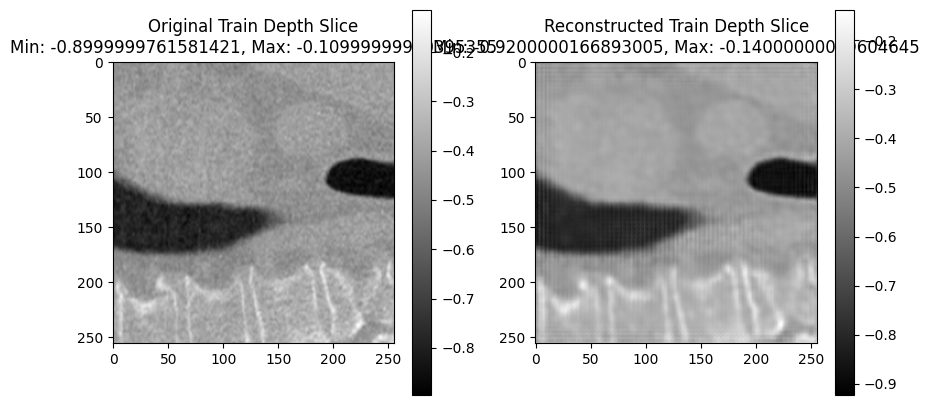

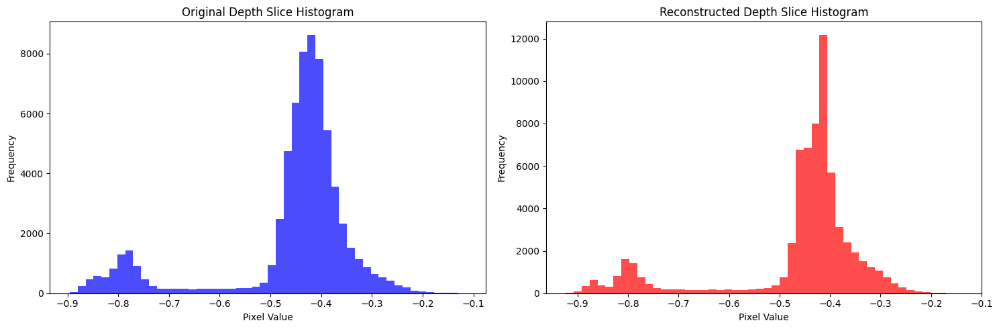

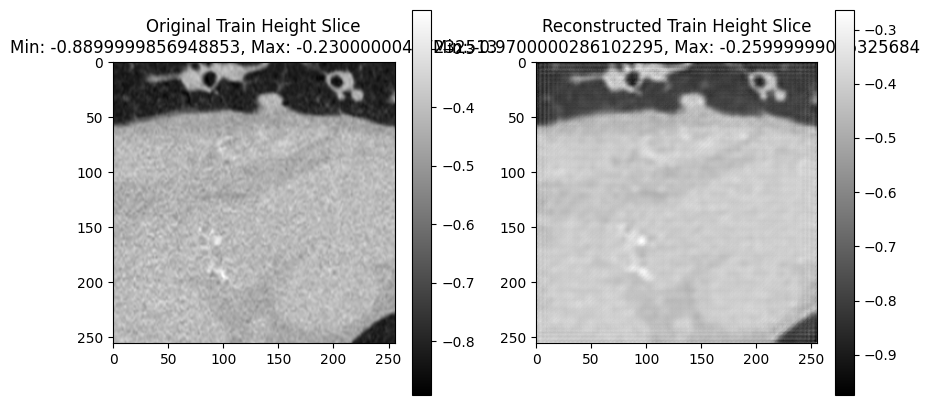

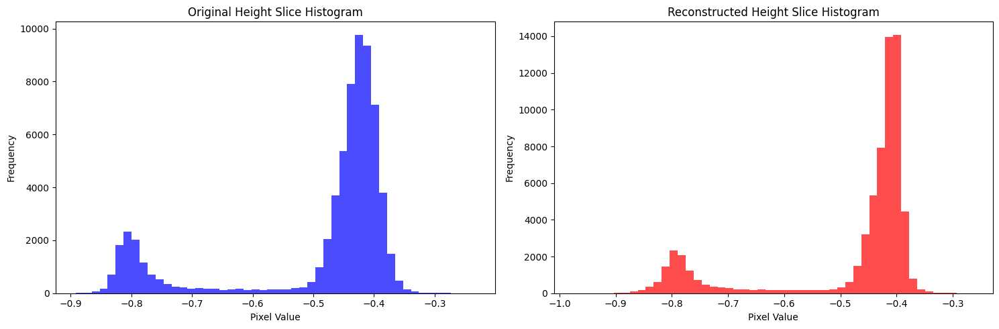

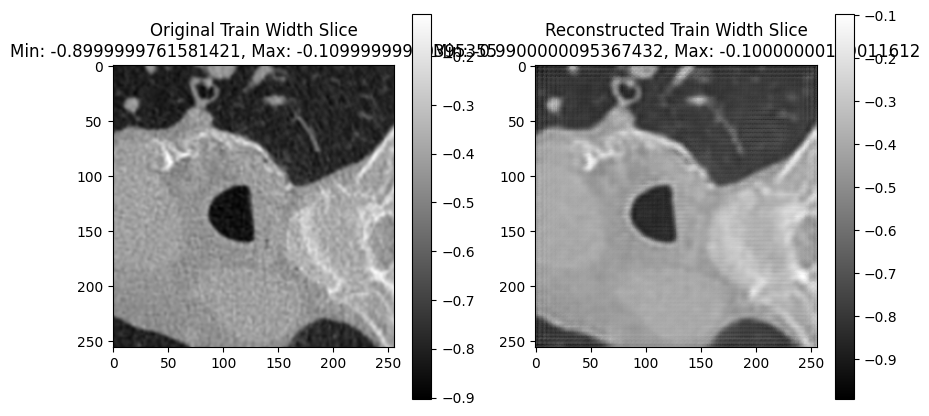

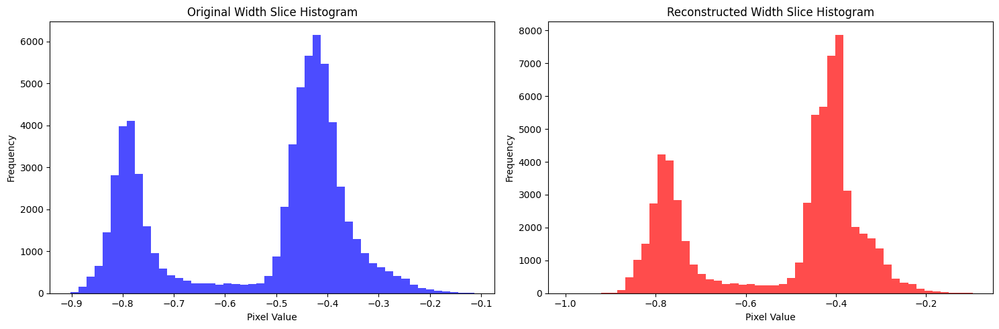

Validation: |          | 0/? [00:00<?, ?it/s]

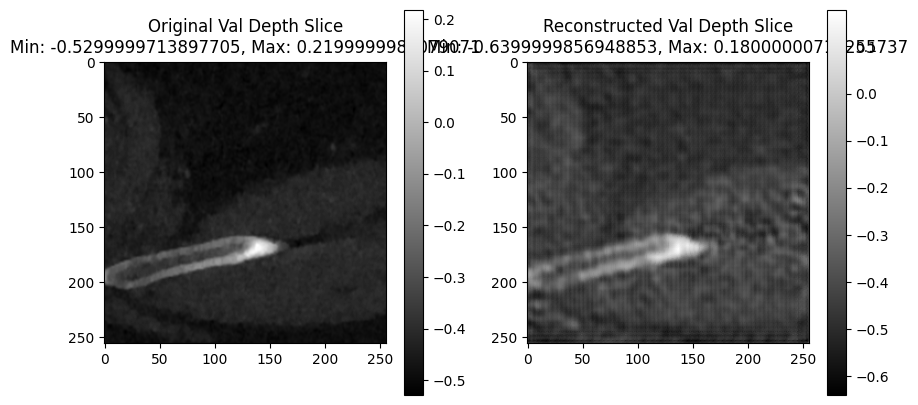

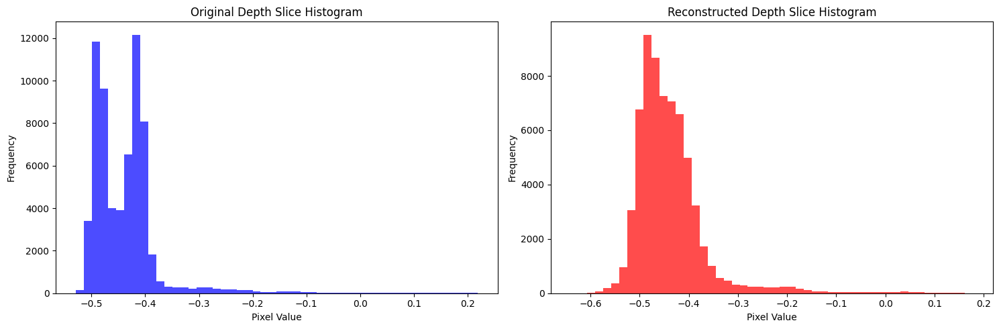

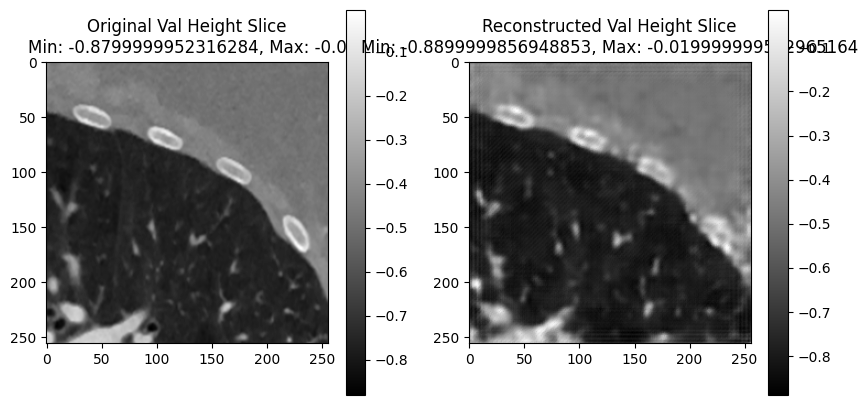

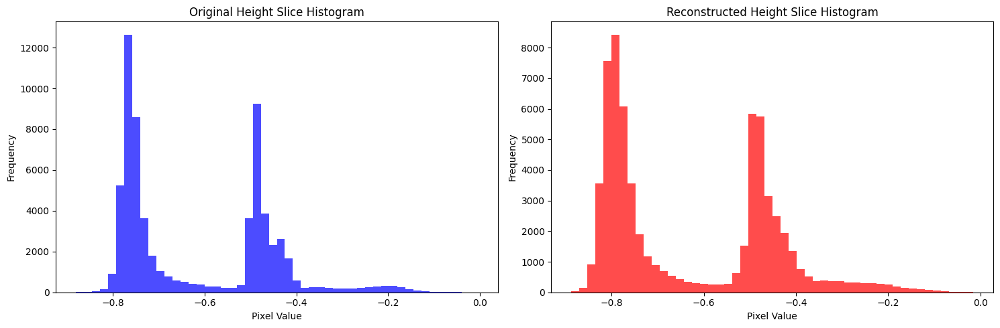

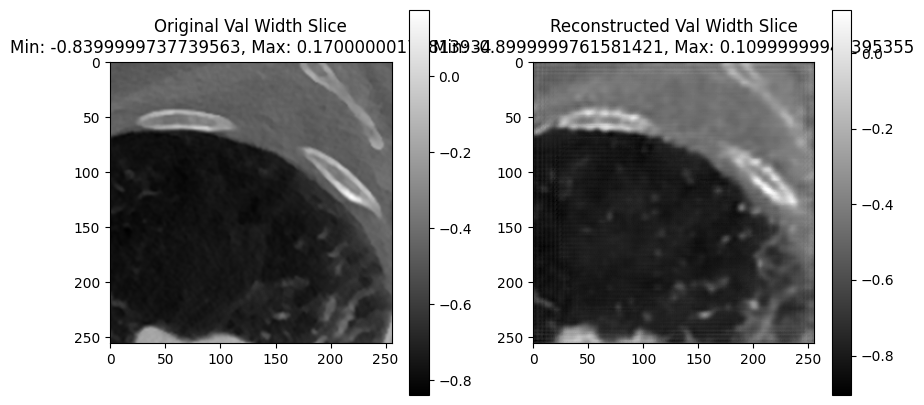

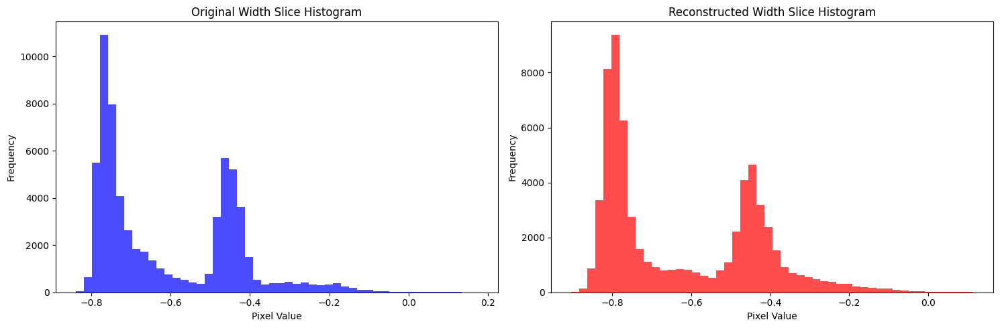

Time Spent 11510.17
Epoch: 1201


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11519.37
Epoch: 1202


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11528.63
Epoch: 1203


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11537.77
Epoch: 1204


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11546.92
Epoch: 1205


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11556.11
Epoch: 1206


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11565.30
Epoch: 1207


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11574.52
Epoch: 1208


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11583.80
Epoch: 1209


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11592.95
Epoch: 1210


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11602.10
Epoch: 1211


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11611.50
Epoch: 1212


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11620.66
Epoch: 1213


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11629.95
Epoch: 1214


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11639.47
Epoch: 1215


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11649.00
Epoch: 1216


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11658.92
Epoch: 1217


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11668.24
Epoch: 1218


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11677.42
Epoch: 1219


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11686.84
Epoch: 1220


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11696.25
Epoch: 1221


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11705.79
Epoch: 1222


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11715.36
Epoch: 1223


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11724.82
Epoch: 1224


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11734.39
Epoch: 1225


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11744.11
Epoch: 1226


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11753.38
Epoch: 1227


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11762.82
Epoch: 1228


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11772.49
Epoch: 1229


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11781.61
Epoch: 1230


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11790.92
Epoch: 1231


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11800.04
Epoch: 1232


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11809.19
Epoch: 1233


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11818.80
Epoch: 1234


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11828.61
Epoch: 1235


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11837.74
Epoch: 1236


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11847.06
Epoch: 1237


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11856.28
Epoch: 1238


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11865.47
Epoch: 1239


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11875.06
Epoch: 1240


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11884.25
Epoch: 1241


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11893.46
Epoch: 1242


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11902.59
Epoch: 1243


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11911.72
Epoch: 1244


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11921.00
Epoch: 1245


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11930.17
Epoch: 1246


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11939.60
Epoch: 1247


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11948.89
Epoch: 1248


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11958.05
Epoch: 1249


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11967.31
Epoch: 1250


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11976.47
Epoch: 1251


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11985.92
Epoch: 1252


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11995.35
Epoch: 1253


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12004.85
Epoch: 1254


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12014.33
Epoch: 1255


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12023.94
Epoch: 1256


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12033.40
Epoch: 1257


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12042.96
Epoch: 1258


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12052.46
Epoch: 1259


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12061.92
Epoch: 1260


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12071.48
Epoch: 1261


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12081.04
Epoch: 1262


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12090.51
Epoch: 1263


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12099.96
Epoch: 1264


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12109.15
Epoch: 1265


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12118.31
Epoch: 1266


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12127.60
Epoch: 1267


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12136.76
Epoch: 1268


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12146.22
Epoch: 1269


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12155.39
Epoch: 1270


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12164.53
Epoch: 1271


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12174.03
Epoch: 1272


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12183.54
Epoch: 1273


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12192.99
Epoch: 1274


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12202.50
Epoch: 1275


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12211.95
Epoch: 1276


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12221.43
Epoch: 1277


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12230.94
Epoch: 1278


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12240.67
Epoch: 1279


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12250.13
Epoch: 1280


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12259.63
Epoch: 1281


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12269.08
Epoch: 1282


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12278.54
Epoch: 1283


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12288.17
Epoch: 1284


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12297.61
Epoch: 1285


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12307.06
Epoch: 1286


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12316.56
Epoch: 1287


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12326.02
Epoch: 1288


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12335.53
Epoch: 1289


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12344.98
Epoch: 1290


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12354.21
Epoch: 1291


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12363.47
Epoch: 1292


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12372.62
Epoch: 1293


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12381.73
Epoch: 1294


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12391.25
Epoch: 1295


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12400.69
Epoch: 1296


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12410.15
Epoch: 1297


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12419.40
Epoch: 1298


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12428.72
Epoch: 1299


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12438.25
Epoch: 1300


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12447.70
Epoch: 1301


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12457.14
Epoch: 1302


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12466.71
Epoch: 1303


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12476.26
Epoch: 1304


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12485.42
Epoch: 1305


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12494.66
Epoch: 1306


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12503.79
Epoch: 1307


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12512.93
Epoch: 1308


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12522.80
Epoch: 1309


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12532.17
Epoch: 1310


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12541.65
Epoch: 1311


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12551.09
Epoch: 1312


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12560.22
Epoch: 1313


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12569.44
Epoch: 1314


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12578.58
Epoch: 1315


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12587.73
Epoch: 1316


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12596.97
Epoch: 1317


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12606.10
Epoch: 1318


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12615.24
Epoch: 1319


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12624.45
Epoch: 1320


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12633.61
Epoch: 1321


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12642.80
Epoch: 1322


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12652.17
Epoch: 1323


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12661.66
Epoch: 1324


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12671.19
Epoch: 1325


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12680.66
Epoch: 1326


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12690.11
Epoch: 1327


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12699.61
Epoch: 1328


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12709.08
Epoch: 1329


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12718.35
Epoch: 1330


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12727.53
Epoch: 1331


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12736.66
Epoch: 1332


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12745.88
Epoch: 1333


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12755.09
Epoch: 1334


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12764.39
Epoch: 1335


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12774.09
Epoch: 1336


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12783.84
Epoch: 1337


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12793.41
Epoch: 1338


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12802.92
Epoch: 1339


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12812.39
Epoch: 1340


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12821.83
Epoch: 1341


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12831.20
Epoch: 1342


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12840.31
Epoch: 1343


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12849.49
Epoch: 1344


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12858.75
Epoch: 1345


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12867.89
Epoch: 1346


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12877.01
Epoch: 1347


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12886.19
Epoch: 1348


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12895.31
Epoch: 1349


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12904.56
Epoch: 1350


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12913.67
Epoch: 1351


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12922.84
Epoch: 1352


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12932.02
Epoch: 1353


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12941.13
Epoch: 1354


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12950.39
Epoch: 1355


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12959.91
Epoch: 1356


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12969.36
Epoch: 1357


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12978.53
Epoch: 1358


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12987.75
Epoch: 1359


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12996.88
Epoch: 1360


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13006.25
Epoch: 1361


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13015.43
Epoch: 1362


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13024.59
Epoch: 1363


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13033.78
Epoch: 1364


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13042.92
Epoch: 1365


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13052.05
Epoch: 1366


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13061.23
Epoch: 1367


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13070.36
Epoch: 1368


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13079.80
Epoch: 1369


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13089.31
Epoch: 1370


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13098.81
Epoch: 1371


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13108.39
Epoch: 1372


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13117.91
Epoch: 1373


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13127.29
Epoch: 1374


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13137.06
Epoch: 1375


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13146.58
Epoch: 1376


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13155.71
Epoch: 1377


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13164.92
Epoch: 1378


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13174.42
Epoch: 1379


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13183.88
Epoch: 1380


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13193.37
Epoch: 1381


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13202.82
Epoch: 1382


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13212.29
Epoch: 1383


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13221.80
Epoch: 1384


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13231.26
Epoch: 1385


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13240.75
Epoch: 1386


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13250.13
Epoch: 1387


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13259.27
Epoch: 1388


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13268.77
Epoch: 1389


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13278.23
Epoch: 1390


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13287.71
Epoch: 1391


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13297.24
Epoch: 1392


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13306.70
Epoch: 1393


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13316.17
Epoch: 1394


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13325.67
Epoch: 1395


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13335.15
Epoch: 1396


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13344.61
Epoch: 1397


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13354.12
Epoch: 1398


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13363.66
Epoch: 1399


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13373.18
Epoch: 1400


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13383.70
Epoch: 1401


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13392.84
Epoch: 1402


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13402.03
Epoch: 1403


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13411.15
Epoch: 1404


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13420.28
Epoch: 1405


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13429.45
Epoch: 1406


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13438.65
Epoch: 1407


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13447.80
Epoch: 1408


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13456.98
Epoch: 1409


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13466.12
Epoch: 1410


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13475.24
Epoch: 1411


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13484.49
Epoch: 1412


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13493.91
Epoch: 1413


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13503.44
Epoch: 1414


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13512.63
Epoch: 1415


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13521.77
Epoch: 1416


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13531.02
Epoch: 1417


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13540.16
Epoch: 1418


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13549.61
Epoch: 1419


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13559.06
Epoch: 1420


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13568.61
Epoch: 1421


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13577.81
Epoch: 1422


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13587.03
Epoch: 1423


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13596.39
Epoch: 1424


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13605.86
Epoch: 1425


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13615.08
Epoch: 1426


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13624.24
Epoch: 1427


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13633.47
Epoch: 1428


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13642.62
Epoch: 1429


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13651.75
Epoch: 1430


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13661.08
Epoch: 1431


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13670.60
Epoch: 1432


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13680.08
Epoch: 1433


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13689.57
Epoch: 1434


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13698.73
Epoch: 1435


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13707.95
Epoch: 1436


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13717.16
Epoch: 1437


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13726.30
Epoch: 1438


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13735.57
Epoch: 1439


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13744.74
Epoch: 1440


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13753.89
Epoch: 1441


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13763.09
Epoch: 1442


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13772.24
Epoch: 1443


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13781.42
Epoch: 1444


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13790.74
Epoch: 1445


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13800.23
Epoch: 1446


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13809.76
Epoch: 1447


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13819.29
Epoch: 1448


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13828.82
Epoch: 1449


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13838.05
Epoch: 1450


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13847.18
Epoch: 1451


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13856.35
Epoch: 1452


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13865.55
Epoch: 1453


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13874.67
Epoch: 1454


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13883.80
Epoch: 1455


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13892.97
Epoch: 1456


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13902.11
Epoch: 1457


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13911.63
Epoch: 1458


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13921.41
Epoch: 1459


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13930.88
Epoch: 1460


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13940.33
Epoch: 1461


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13949.83
Epoch: 1462


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13959.33
Epoch: 1463


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13968.85
Epoch: 1464


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13978.30
Epoch: 1465


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13987.77
Epoch: 1466


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13997.26
Epoch: 1467


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14006.71
Epoch: 1468


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14016.20
Epoch: 1469


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14025.79
Epoch: 1470


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14035.23
Epoch: 1471


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14044.37
Epoch: 1472


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14053.56
Epoch: 1473


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14062.73
Epoch: 1474


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14071.96
Epoch: 1475


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14081.11
Epoch: 1476


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14090.26
Epoch: 1477


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14099.46
Epoch: 1478


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14108.59
Epoch: 1479


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14117.73
Epoch: 1480


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14127.06
Epoch: 1481


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14136.19
Epoch: 1482


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14145.63
Epoch: 1483


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14154.89
Epoch: 1484


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14164.01
Epoch: 1485


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14173.15
Epoch: 1486


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14182.39
Epoch: 1487


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14191.58
Epoch: 1488


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14200.80
Epoch: 1489


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14210.14
Epoch: 1490


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14219.36
Epoch: 1491


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14228.56
Epoch: 1492


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14237.72
Epoch: 1493


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14246.96
Epoch: 1494


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14256.32
Epoch: 1495


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14265.62
Epoch: 1496


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14274.86
Epoch: 1497


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14284.28
Epoch: 1498


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14293.60
Epoch: 1499


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14302.98
Epoch: 1500


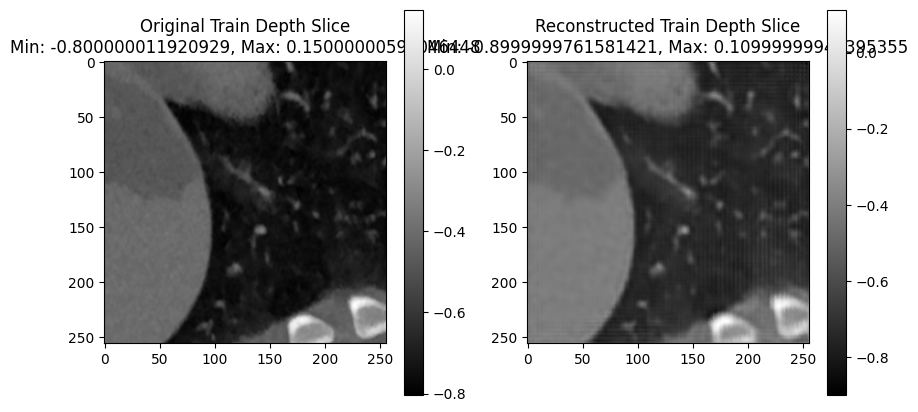

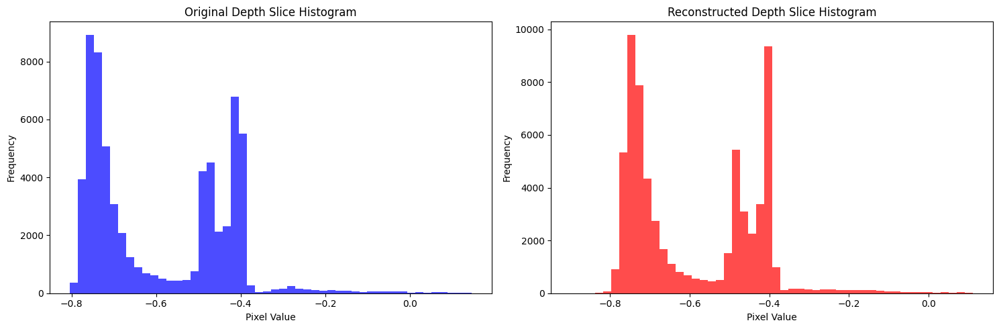

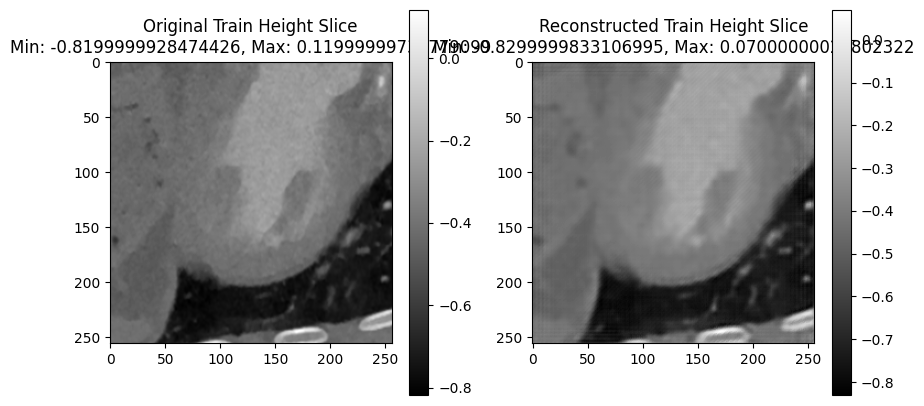

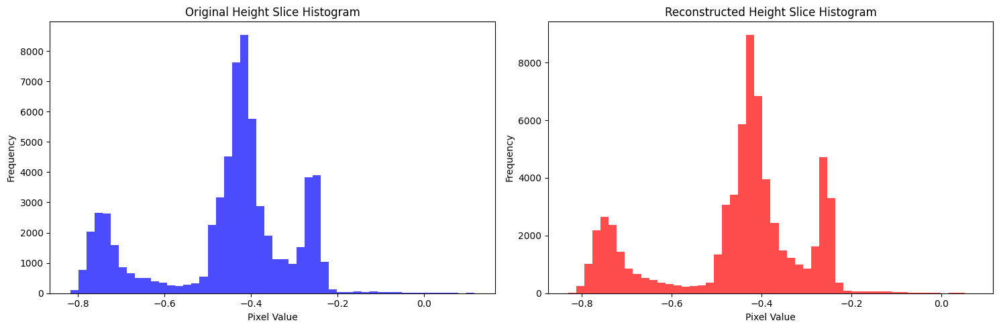

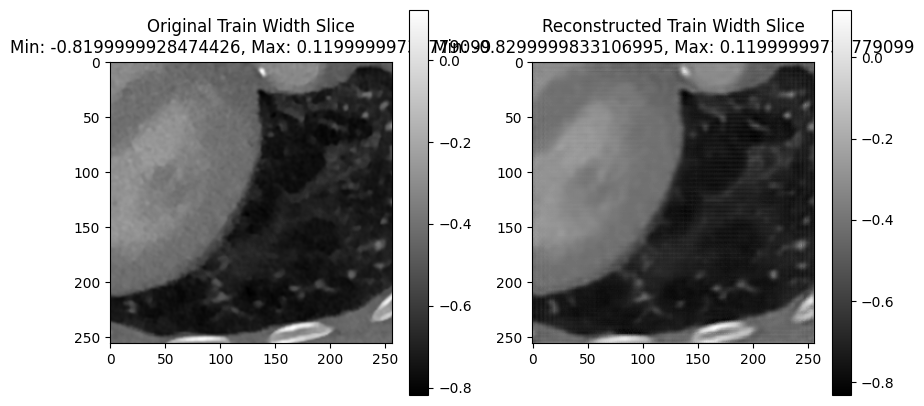

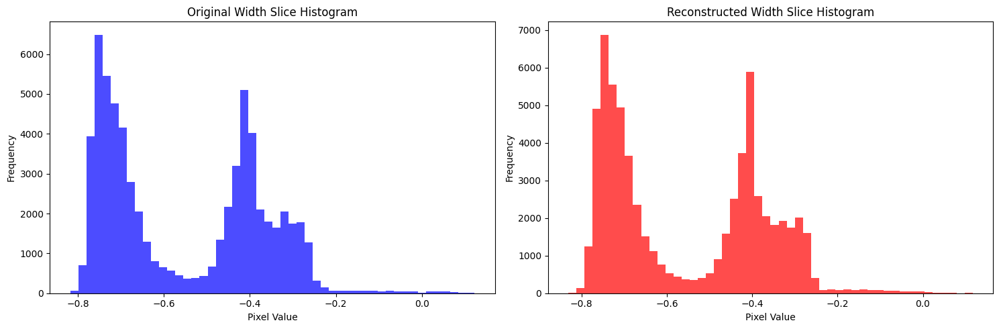

Validation: |          | 0/? [00:00<?, ?it/s]

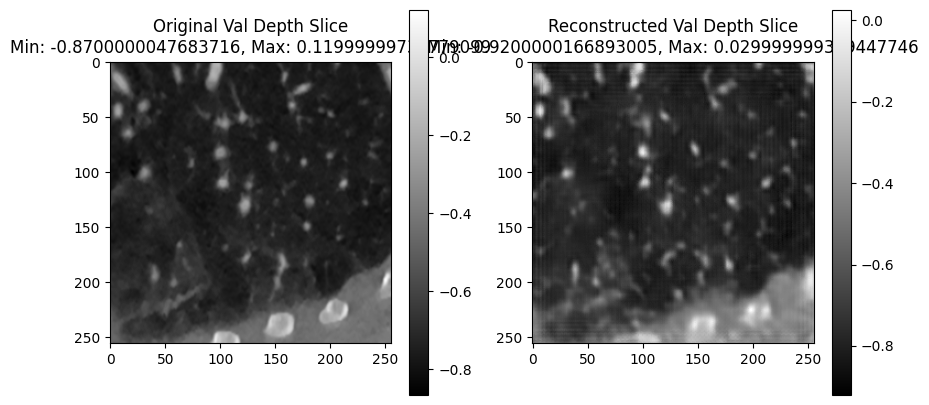

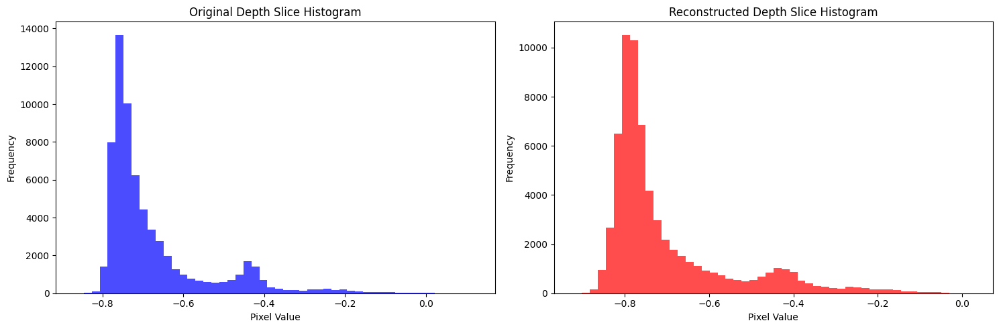

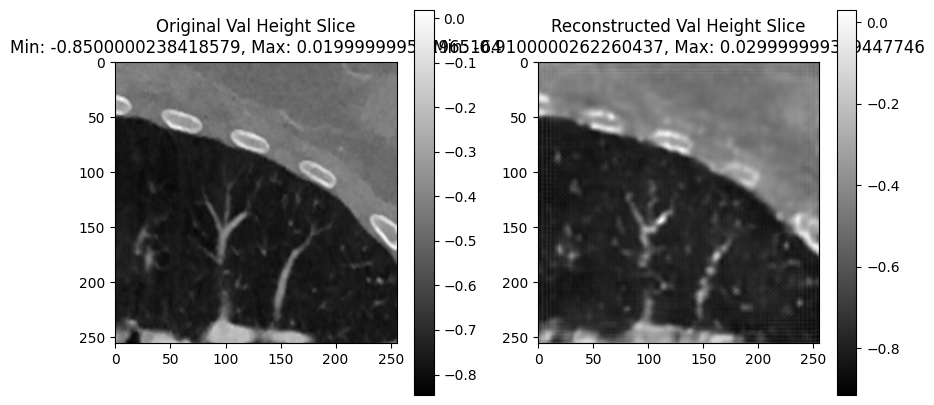

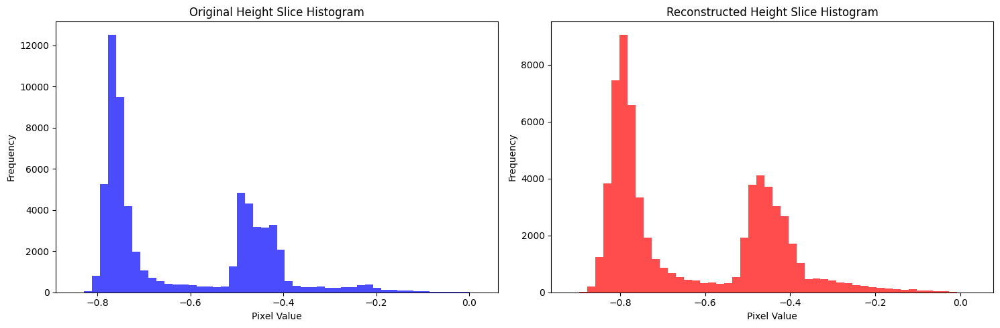

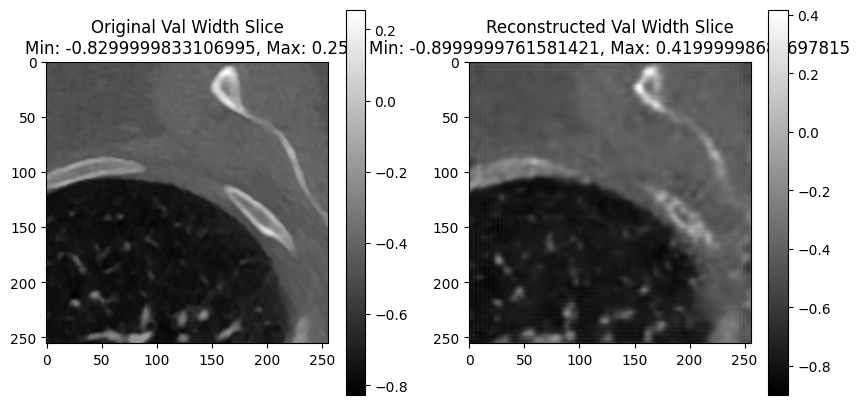

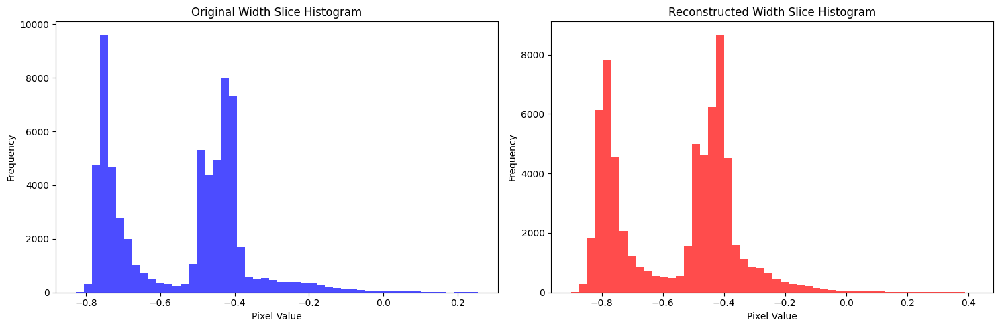

Time Spent 14318.99
Epoch: 1501


`Trainer.fit` stopped: `max_epochs=1501` reached.


FIT Profiler Report

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  Action                                                                                                                                                           	|  Mean duration (s)	|  Num calls      	|  Total time (s) 	|  Percentage %   	|
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  Total                                                                                                                                                            	|  -              	|  1387057      

In [5]:
# Initialize model and start training
ExperimentDescription = 'I-AE Job10 264C Loss'
ShowInterval = 300
model = AutoEncoderModel()
trainer.fit(model, train_dataloader, val_dataloader)
# torch.save(model.state_dict(), folder_path + '/aeSSIM.pth')